# Import what we need

In [1]:
import sys
import numpy as np
import pandas as pd
import scanpy as sc
import anndata as ad
from scipy.sparse import csr_matrix
import logging
import os
import matplotlib.pyplot as plt
import seaborn as sns
import csv
import scipy.stats as stats
import statsmodels.formula.api as smf
import statsmodels.api as sm
import math
import gc
import random

In [2]:
%matplotlib inline

##################
# Configure file #
##################
sc.settings.verbosity = 2
sc.settings.autoshow = False

##logging.basicConfig(filename="CLUESImmVar_processed.V4.1.log", level=logging.ERROR)
sc.settings.set_figure_params(dpi=100, dpi_save=600, format='png')

plt.rcParams["image.aspect"] = "equal"

# Read in the data, this could take a while

In [3]:
adata = sc.read('V5.1.2.flareAb.h5ad', cache=True)
print(adata)
figdir = "./figures."
sc.settings.figdir = "./figures."

Only considering the two last: ['.flareAb', '.h5ad'].
Only considering the two last: ['.flareAb', '.h5ad'].
AnnData object with n_obs × n_vars = 137936 × 1174 
    obs: 'SOURCE', 'TR_UNT', 'batch_cov', 'ind_cov', 'well', 'Female', 'Broad', 'CD38|CD38|j95-01|pAbO', 'CD95|FAS|j95-02|pAbO', 'CD28|CD28|j95-07|pAbO', 'CD27|CD27|j95-08|pAbO', 'CD197|CCR7|j95-09|pAbO', 'CD19|CD19|j95-10|pAbO', 'CD161|KLRB1|j95-11|pAbO', 'CD183|CXCR3|j95-12|pAbO', 'CD4|CD4|j95-14|pAbO', 'CD3|CD3E|j95-16|pAbO', 'CD196|CCR6|j95-17|pAbO', 'HLA-DR|CD74|j95-18|pAbO', 'CD45RO|PTPRC|j95-19|pAbO', 'CD14|CD14|j95-20|pAbO', 'CD194|CCR4|j95-21|pAbO', 'CD185|CXCR5|j95-22|pAbO', 'CD25|IL2RA|j95-24|pAbO', 'CD8|CD8A|j95-25|pAbO', 'CD127|IL7R|j95-27|pAbO', 'CD45RA|PTPRC|j95-28|pAbO', 'disease_cov', 'percent_mito', 'n_counts', 'n_genes', 'PF4', 'SDPR', 'GNG11', 'PPBP', 'PC3', 'PC16', 'louvain', 'leiden'
    uns: 'barcodes', 'diffmap_evals', 'genes', 'leiden', 'louvain', 'neighbors', 'pca', 'raw_counts', 'total_pbmcs'
    obsm:

In [4]:
# id	source	status
# 101	HEALTHY	UCSF
# 1771	HEALTHY	UCSF/CLUES
# 256	HEALTHY	IMMVAR
# 1921	HEALTHY	IMMVAR
# 1290	HEALTHY	IMMVAR
# 514	HEALTHY	IMMVAR
# 1791	HEALTHY	UCSF/CLUES
# 1754	HEALTHY	UCSF/CLUES
# 1586 (002, 003, or 008)	FLARE	FLARE
# 1763 (002, 003, or 008)	FLARE	FLARE
# 904194200 (002, 003, or 008)	FLARE	FLARE
# 1804 (900805200)	HEALTHY	UCSF/CLUES

In [5]:
# Sample ID	Date of Draw	Lupus Flare  	CLUES 	CLUES ID
# 001-01	8/14/2017	Yes	No	
# 001-02	12/18/2017	No - symptoms have improved some, but patient did not start meds		
# 002-01	8/30/2017	Yes	yes	1586
# 002-02	11/29/2017	No	yes	1586
# 003-01	9/6/2017	Yes	yes	1130
# 003-02	12/6/2017	No	yes	1130
# 004-01	9/13/2017	Yes	yes - no blood	2195
# 004-02	10/4/2017	No	yes - no blood	2195
# 005-01	9/25/2017	Yes	no	
# 006-01	10/3/2017	Yes	no	
# 007-01	10/11/2017	Yes	yes - no blood	
# 008-01	11/13/2017	Yes		
# 008-02	3/16/2018	No	yes	1763
# 009-01	11/20/2017	Yes		
# 009-02	3/15/2018	No - however disease activity still high	no	
# 010-01	12/4/2017	Yes	no	
# 010-02	3/19/2018	No	yes - no blood	1540
# 011-01	12/4/2017	Yes	no	
# 012-01	12/11/2017	Yes	no	
# 012-02	3/26/2018	No	no	
# 013-01	1/8/2018	Yes	no	
# 013-02	2/26/2018	No - improved but patient not fully in remission	no	
# 014-01	1/9/2018		yes - no blood	1550
# 015-01	1/23/2018	Yes	no	
# 016-01	1/29/2018	Yes	yes - no blood	1524
# 017-01	2/26/2018	Yes	yes - no blood	1563
# 018-01	3/19/2018	yes	yes	1772
# 019-01	3/21/2018	yes	yes	2132
# 020-01	3/5/2018	yes	no	

In [6]:
# 	ID	SOURCE	STATUS	PAIR
# 3 - demux	HC-502-01	UCSF	HEALTHY	FALSE
# 3 - demux	FLARE016-01	FLARE	TR	TRUE
# 3 - demux	FLARE014-01	FLARE	UNT	FALSE
# 3 - demux	IGTB195	IMMVAR	HEALTHY	FALSE
# 3 - demux	FLARE013-01	FLARE	TR	TRUE
# 3 - demux	FLARE006-01	FLARE	UNT	FALSE
# 3 - demux	101	UCSF	HEALTHY	FALSE
# 3 - demux	HC-504-01	UCSF	HEALTHY	FALSE
# 3 - demux	FLARE015-01	FLARE	UNT	FALSE
# 3 - demux	FLARE007-01	FLARE	UNT	FALSE
# 3 - demux	FLARE005-01	FLARE	UNT	FALSE
# 3 - demux	IGTB508	IMMVAR	HEALTHY	FALSE
# 3 - demux	FLARE009-01	FLARE	UNT	TRUE
# 3 - demux	IGTB826	IMMVAR	HEALTHY	FALSE
# 3 - demux	HC-501-01	UCSF	HEALTHY	FALSE
# 3 - demux	FLARE004-01	FLARE	UNT	TRUE
# 3 - demux	FLARE011-01	FLARE	TR	TRUE
# 4 - demux	2132DNA01	FLARE	UNT	FALSE
# 4 - demux	101	UCSF	HEALTHY	FALSE
# 4 - demux	FLARE013-01	FLARE	UNT	TRUE
# 4 - demux	FLARE016-01	FLARE	UNT	TRUE
# 4 - demux	IGTB469	IMMVAR	HEALTHY	FALSE
# 4 - demux	HC-002-01	UCSF	HEALTHY	FALSE
# 4 - demux	HC-020-01	UCSF	HEALTHY	FALSE
# 4 - demux	1772	FLARE	UNT	FALSE
# 4 - demux	IGTB1372	IMMVAR	HEALTHY	FALSE
# 4 - demux	FLARE020-01	FLARE	UNT	FALSE
# 4 - demux	HC-506-01	UCSF	HEALTHY	FALSE
# 4 - demux	HC-503-01	UCSF	HEALTHY	FALSE
# 4 - demux	FLARE009-01	FLARE	TR	TRUE
# 4 - demux	HC-014-01	UCSF	HEALTHY	FALSE
# 4 - demux	FLARE004-01	FLARE	TR	TRUE
# 4 - demux	IGTB1506	IMMVAR	HEALTHY	FALSE
# 4 - demux	FLARE011-01	FLARE	UNT	TRUE
# 4 - demux	FLARE017-01	FLARE	UNT	FALSE
# 3 - freemux	HC-502	UCSF	HEALTHY	FALSE
# 3 - freemux	FLARE016	FLARE	TR	TRUE
# 3 - freemux	FLARE014	FLARE	UNT	FALSE
# 3 - freemux	IGTB195	IMMVAR	HEALTHY	FALSE
# 3 - freemux	FLARE013	FLARE	TR	TRUE
# 3 - freemux	FLARE006	FLARE	UNT	FALSE
# 3 - freemux	101	UCSF	HEALTHY	FALSE
# 3 - freemux	HC-504	UCSF	HEALTHY	FALSE
# 3 - freemux	FLARE015	FLARE	UNT	FALSE
# 3 - freemux	FLARE007	FLARE	UNT	FALSE
# 3 - freemux	FLARE005	FLARE	UNT	FALSE
# 3 - freemux	IGTB508	IMMVAR	HEALTHY	FALSE
# 3 - freemux	FLARE009	FLARE	UNT	TRUE
# 3 - freemux	IGTB826	IMMVAR	HEALTHY	FALSE
# 3 - freemux	HC-501	UCSF	HEALTHY	FALSE
# 3 - freemux	FLARE004	FLARE	UNT	TRUE
# 3 - freemux	FLARE011	FLARE	TR	TRUE
# 3 - freemux	FLARE010	FLARE	TR	TRUE
# 3 - freemux	FLARE001	FLARE	UNT	TRUE
# 4 - freemux	2132DNA01	FLARE	UNT	FALSE
# 4 - freemux	101	UCSF	HEALTHY	FALSE
# 4 - freemux	FLARE013	FLARE	UNT	TRUE
# 4 - freemux	FLARE016	FLARE	UNT	TRUE
# 4 - freemux	IGTB469	IMMVAR	HEALTHY	FALSE
# 4 - freemux	HC-002	UCSF	HEALTHY	FALSE
# 4 - freemux	HC-020	UCSF	HEALTHY	FALSE
# 4 - freemux	1772	FLARE	UNT	FALSE
# 4 - freemux	IGTB1372	IMMVAR	HEALTHY	FALSE
# 4 - freemux	FLARE020	FLARE	UNT	FALSE
# 4 - freemux	HC-506	UCSF	HEALTHY	FALSE
# 4 - freemux	HC-503	UCSF	HEALTHY	FALSE
# 4 - freemux	FLARE009	FLARE	TR	TRUE
# 4 - freemux	HC-014	UCSF	HEALTHY	FALSE
# 4 - freemux	FLARE004	FLARE	TR	TRUE
# 4 - freemux	IGTB1506	IMMVAR	HEALTHY	FALSE
# 4 - freemux	FLARE011	FLARE	UNT	TRUE
# 4 - freemux	FLARE017	FLARE	UNT	FALSE
# 4 - freemux	FLARE010	FLARE	UNT	TRUE
# 4 - freemux	FLARE001	FLARE	TR	TRUEa

In [7]:
print(np.unique(adata.obs.ind_cov.tolist()))

['1240' '1754_1754' '1771_1771' '1772' '1791_1791' '1804_1804'
 '900805200_900805200' 'FLARE004' 'FLARE005' 'FLARE006' 'FLARE007'
 'FLARE009' 'FLARE011' 'FLARE013' 'FLARE014' 'FLARE015' 'FLARE016'
 'FLARE017' 'FLARE020' 'HC-002' 'HC-014' 'HC-020' 'HC-501' 'HC-502'
 'HC-503' 'HC-504' 'HC-506' 'IGTB1290' 'IGTB1372' 'IGTB1506' 'IGTB1921'
 'IGTB195' 'IGTB256' 'IGTB469' 'IGTB508' 'IGTB514' 'IGTB826']


In [8]:
## from runs 1 and 2
## these are labeled as healthy from CLUES but pretty sure they are treated CLUES samples
## and not true healthies
adata.obs['disease_cov'] = adata.obs['disease_cov'].astype('object')
adata.obs.loc[adata.obs.ind_cov == "1754_1754","disease_cov"] = "TR"
adata.obs.loc[adata.obs.ind_cov == "1771_1771","disease_cov"] = "TR"
adata.obs.loc[adata.obs.ind_cov == "1791_1791","disease_cov"] = "TR"
adata.obs.loc[adata.obs.ind_cov == "900805200_900805200","disease_cov"] = "TR"

## from run 3 and 4
adata.obs.loc[adata.obs.ind_cov == "1772","disease_cov"] = "UNT"


In [9]:
## not sure what the mapping should be here...
## just know that all three samples are in runs 1 and 2
## should be flare2, flare3 and flare8
adata.obs.loc[(adata.obs.ind_cov == "1586") & (adata.obs.batch_cov == "flare.1"),"disease_cov"] = "TR"
adata.obs.loc[(adata.obs.ind_cov == "1586") & (adata.obs.batch_cov == "flare.2"),"disease_cov"] = "UNT"

adata.obs.loc[(adata.obs.ind_cov == "1763") & (adata.obs.batch_cov == "flare.1"),"disease_cov"] = "UNT"
adata.obs.loc[(adata.obs.ind_cov == "1763") & (adata.obs.batch_cov == "flare.2"),"disease_cov"] = "TR"

adata.obs.loc[(adata.obs.ind_cov == "904194200") & (adata.obs.batch_cov == "flare.1"),"disease_cov"] = "UNT"
adata.obs.loc[(adata.obs.ind_cov == "904194200") & (adata.obs.batch_cov == "flare.2"),"disease_cov"] = "TR"


In [10]:
# HC-502-01 is not existent
# 101 is not existent, that's actually 1240?

# Make some diagnostic plots

## Next, check batch effects

... storing 'disease_cov' as categorical
... storing 'disease_cov' as categorical
... storing 'disease_cov' as categorical
... storing 'disease_cov' as categorical


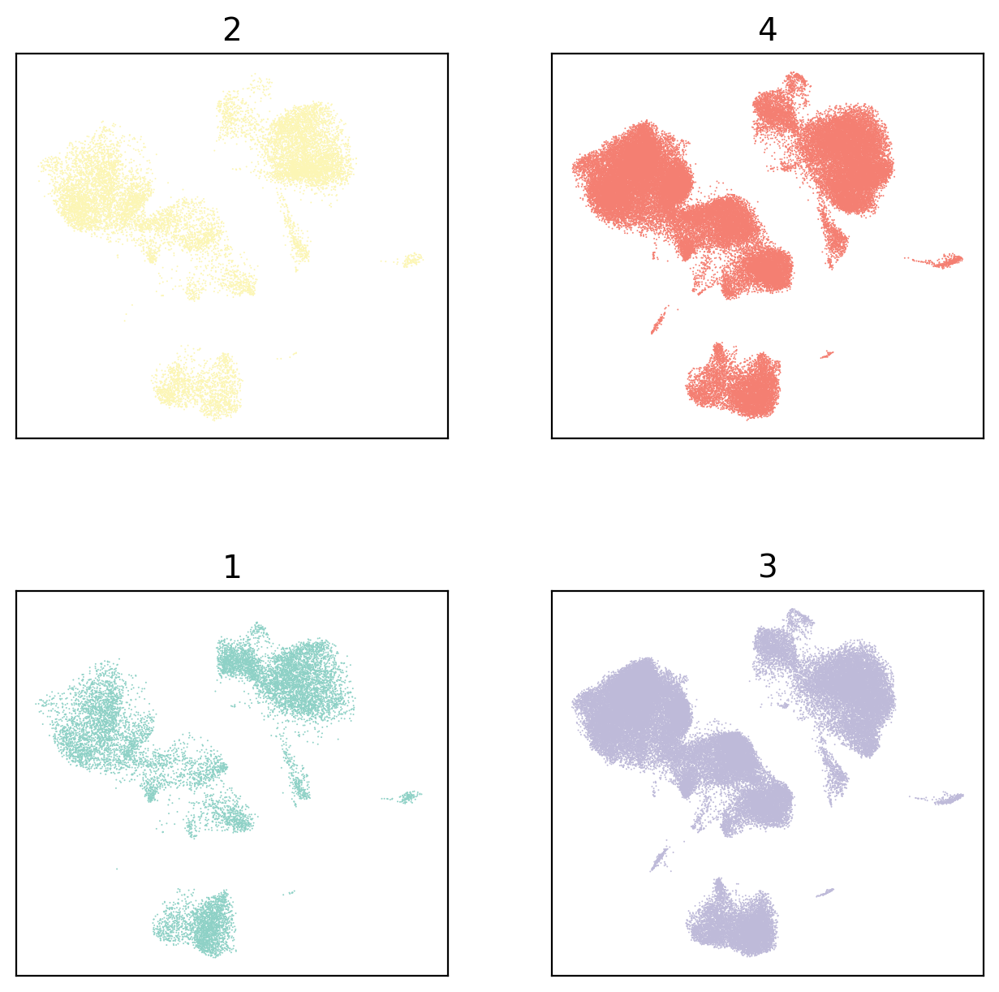

In [11]:
##sc.pl.umap(adata, color=['batch_cov'])
colors = ["#8ED1C6","#FCF6B5", "#BEBAD9", "#F47F72", "#81B1D3", "#FBB463", "#B4D66C", "#F9CEE1", "#DAD9D9", "#BC80B7", "#CDE6C4", "#FEEC6E", "#E31F26", "#387EB9", "#4EAF49", "#984F9F"];

fig,ax = plt.subplots(nrows=2,ncols=2, figsize=(7,7), sharex=True, sharey=True)
fig.tight_layout()
##plt.subplots_adjust(left=0, right=0.1, top=0.1, bottom=0, wspace=0.1, hspace=0.1)
##plt.subplots_adjust(wspace=0.1, hspace=0.1)

for batch_i in range(len(adata.obs.batch_cov.unique())) :
    batch = adata.obs.batch_cov.unique()[batch_i]
    col = colors[batch_i]
    sc.pl.umap(adata[adata.obs.batch_cov==batch,], color = "batch_cov", title=None, palette=[col,col], ax=ax[(batch_i-1)%2,math.floor(batch_i/2)], size=2, edgecolor="none")
    ##ax[(ind_i-1)%4,math.floor(ind_i/4)].label_outer()
    ax[(batch_i-1)%2,math.floor(batch_i/2)].get_xaxis().set_visible(False)
    ax[(batch_i-1)%2,math.floor(batch_i/2)].get_yaxis().set_visible(False)
    ax[(batch_i-1)%2,math.floor(batch_i/2)].get_legend().remove()
    ax[(batch_i-1)%2,math.floor(batch_i/2)].set_title(batch)
    ax[(batch_i-1)%2,math.floor(batch_i/2)].set_aspect("equal")
    
fig.savefig(figdir+'umap.batch.png')

# Figure 1B: Projection and dropprint

## Next, make the disease plot

... storing 'disease_cov' as categorical


saving figure to file ./figures./umap.disease.png


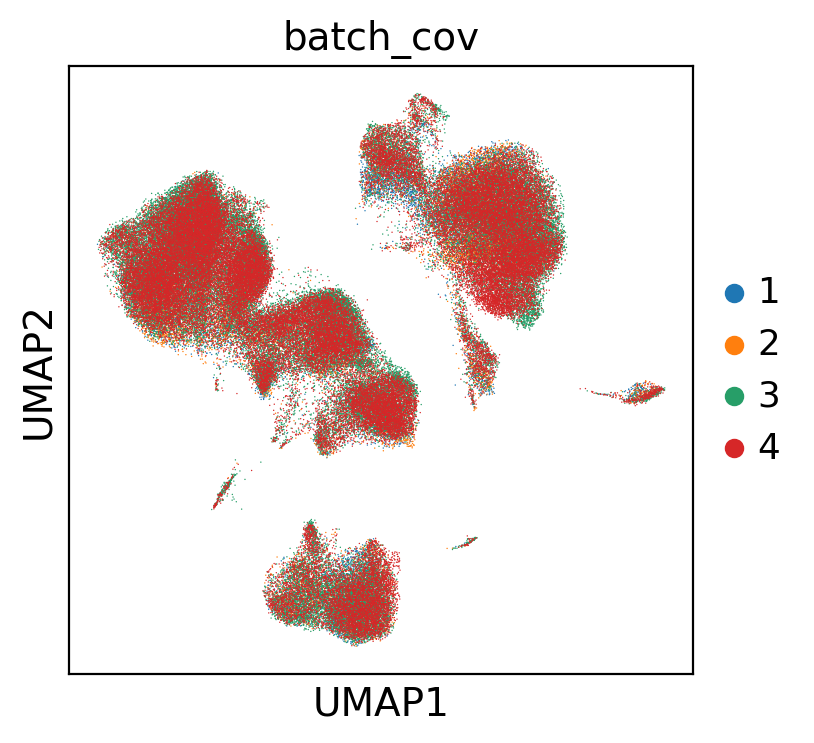

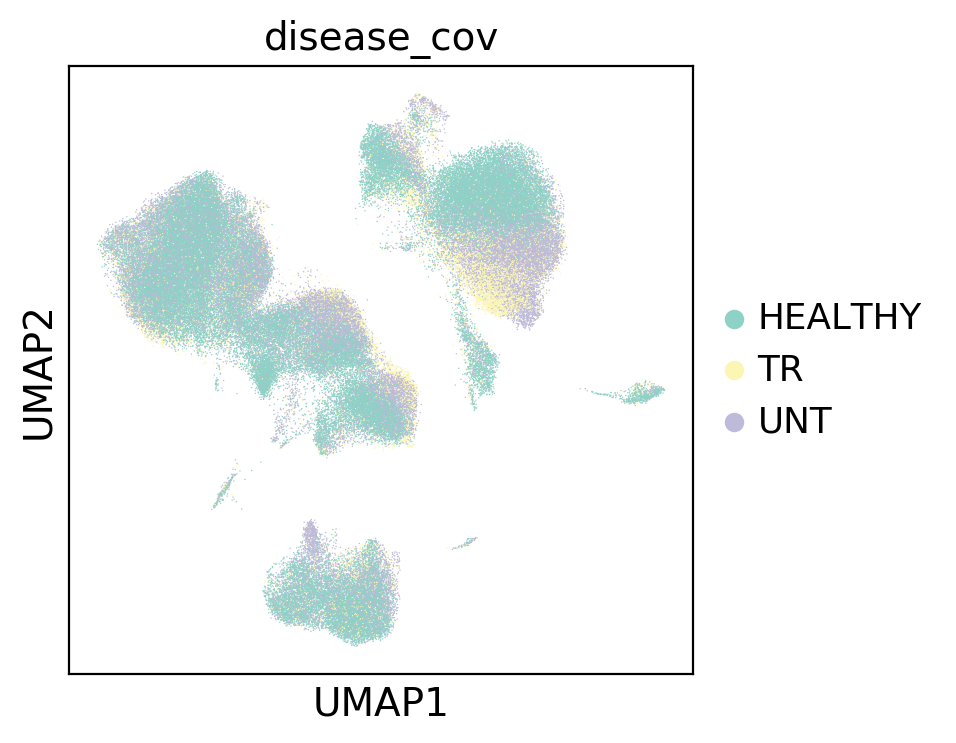

In [12]:
disease_umap = sc.pl.umap(adata, color='batch_cov', size=1, edgecolor="none")
disease_umap = sc.pl.umap(adata, color='disease_cov', size=1, edgecolor="none", palette=["#8ED1C6","#FCF6B5", "#BEBAD9", "#F47F72"])
disease_umap = sc.pl.umap(adata, color='disease_cov', size=1, edgecolor="none", palette=["#8ED1C6","#FCF6B5", "#BEBAD9", "#F47F72"], save='.disease.png')

In [13]:
# ## Make disease plot (Fig. 1B)
# ## flipping the disease labels so that the healthy plots on top of the sle
# adata.obs['disease_cov'] = pd.Categorical(adata.obs['disease_cov'],categories=['sle','healthy'], ordered=True)
# ##adata.uns['disease_cov_colors'] = ['#3A87BC','#ED8A2F'];

# ##disease_tsne = sc.pl.tsne(adata, color='disease_cov', size=0.5)
# ##celltype_umap = sc.pl.umap(adata, color='ct_cov', size=1, edgecolor="none", save='.png')
# disease_umap = sc.pl.umap(adata, color='disease_cov', size=1, edgecolor="none", save='.disease.png')
# disease_umap = sc.pl.umap(adata, color='disease_cov', size=1, edgecolor="none")

# ## testing returning an axes object which should allow for more customization
# ## disease_tsne2 = sc.pl.tsne(adata, color='disease_cov', size=0.5, show=False)

# ## flipping the disease/healthy labels back for all of the downstream analysis
# adata.obs['disease_cov'] = pd.Categorical(adata.obs['disease_cov'],categories=['healthy','sle'], ordered=True)

## Now, let's make a plot for each of the 16 people in batch 1 as a demo of variability

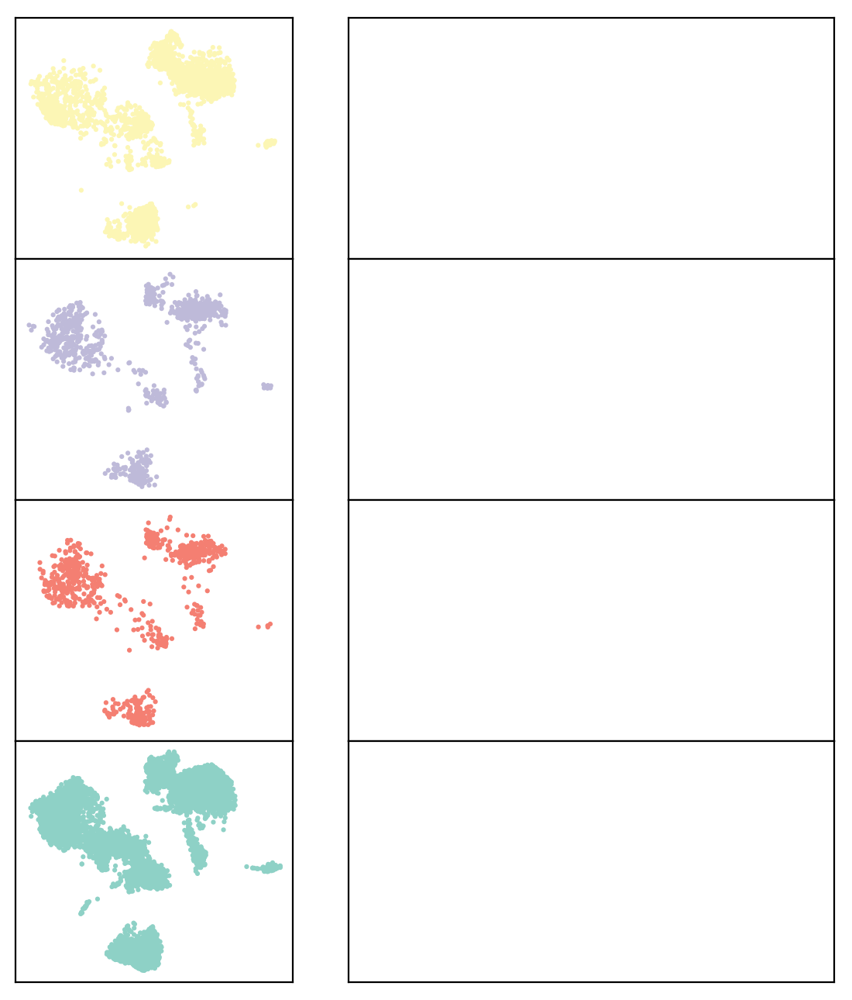

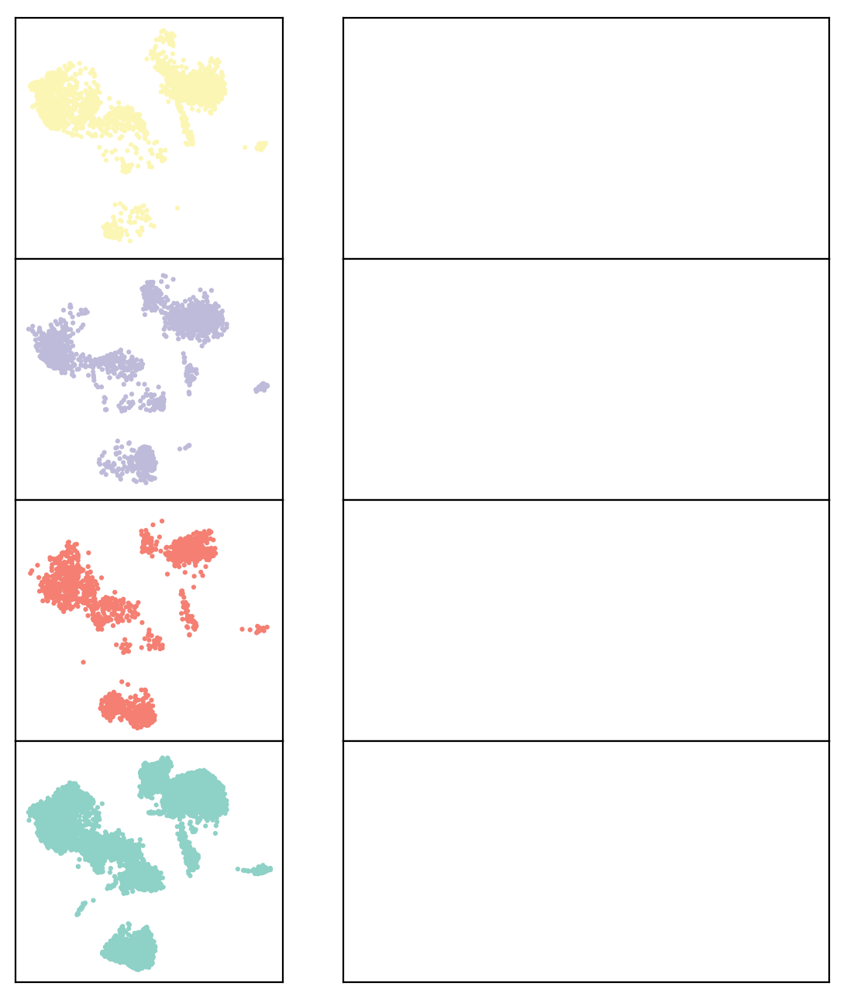

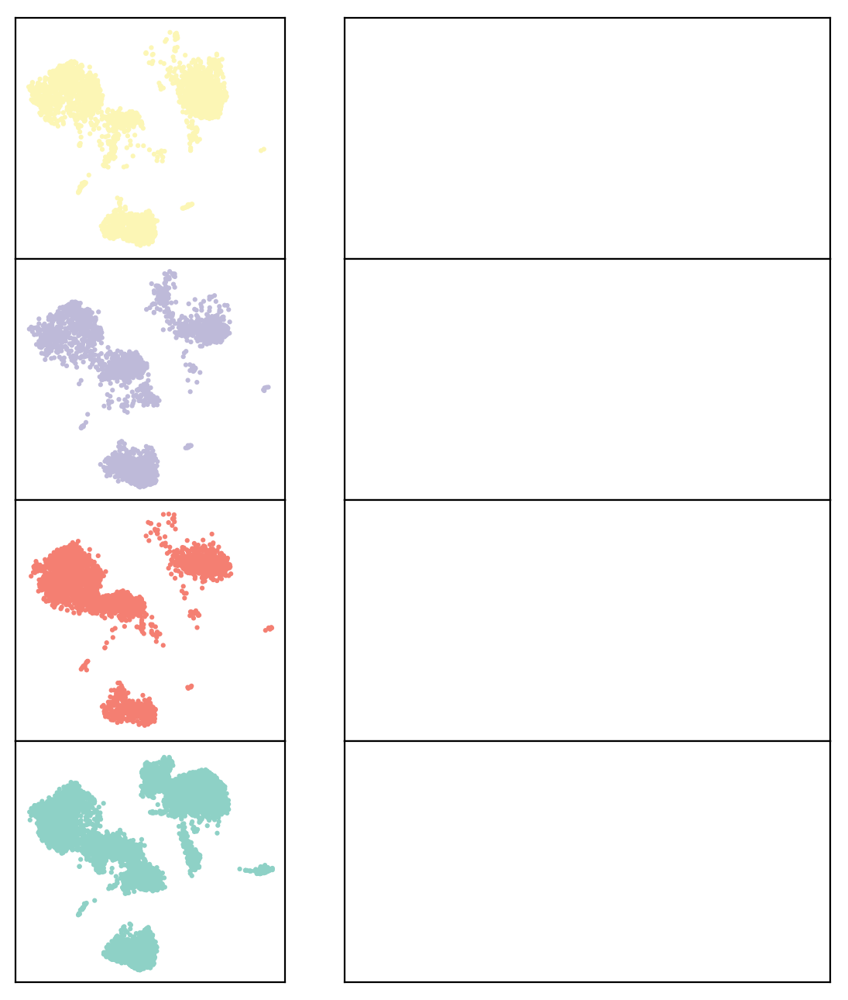

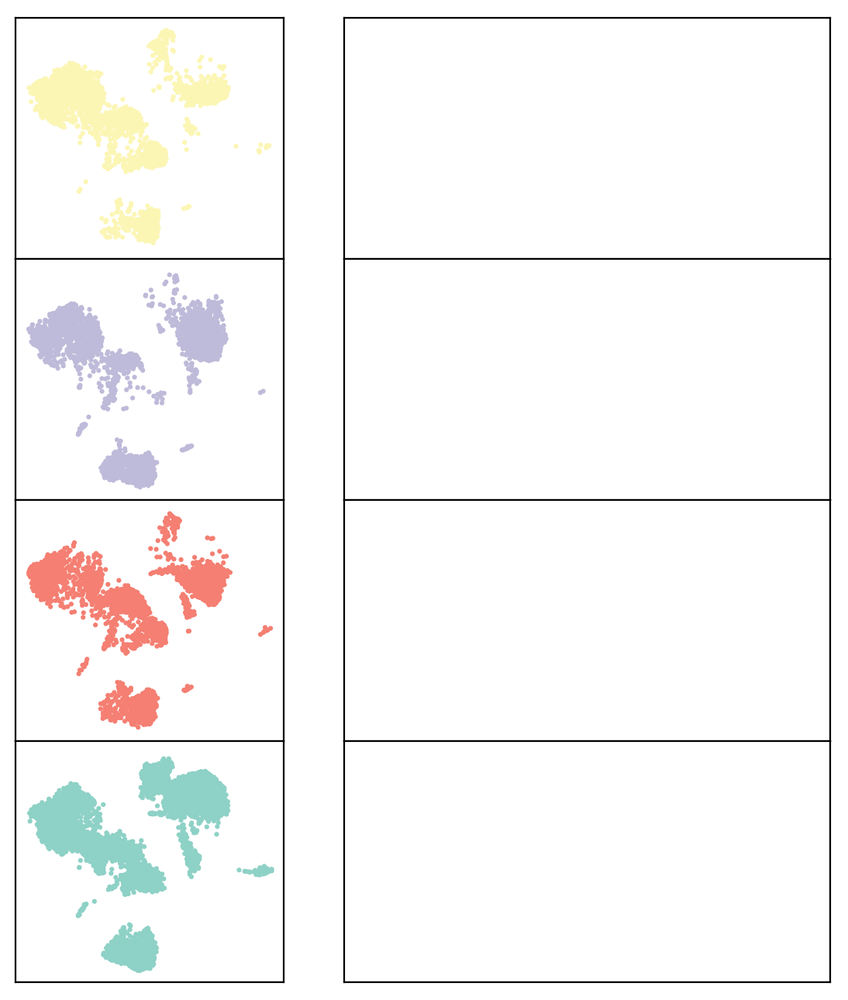

In [14]:
## let's plot 16 plots for the individuals in the first batch (Fig. 1B)
colors = ["#8ED1C6","#FCF6B5", "#BEBAD9", "#F47F72", "#81B1D3", "#FBB463", "#B4D66C", "#F9CEE1", "#DAD9D9", "#BC80B7", "#CDE6C4", "#FEEC6E", "#E31F26", "#387EB9", "#4EAF49", "#984F9F", "#984F9F"];
##batch_07_19_inds = adata.obs.ind_cov[adata.obs.batch_cov=='lupus7.19'].unique()
##batch_07_19_inds = np.sort(batch_07_19_inds.categories.values);

for batch_i in range(len(adata.obs.batch_cov.unique())) :
    fig,ax = plt.subplots(nrows=4,ncols=2, figsize=(7,7),sharex=True, sharey=True)
    fig.tight_layout()
    ##plt.subplots_adjust(left=0, right=0.1, top=0.1, bottom=0, wspace=0.1, hspace=0.1)
    plt.subplots_adjust(wspace=-0.1, hspace=0)

    batch_name = adata.obs.batch_cov.unique()[batch_i]
    batch = adata.obs.ind_cov[adata.obs.batch_cov==batch_name].unique();
    batch = np.sort(batch.categories.values)

    for ind_i in list(range(4)) :
        ind = batch[ind_i]
        col = colors[ind_i]
        sc.pl.umap(adata[adata.obs.ind_cov==ind,], color = "ind_cov", title=None, palette=[col,col], ax=ax[(ind_i-1)%4,math.floor(ind_i/4)], size=20, edgecolor="none")
        ##ax[(ind_i-1)%4,math.floor(ind_i/4)].label_outer()
        ax[(ind_i-1)%4,math.floor(ind_i/4)].get_xaxis().set_visible(False)
        ax[(ind_i-1)%4,math.floor(ind_i/4)].get_yaxis().set_visible(False)
        ax[(ind_i-1)%4,math.floor(ind_i/4)].get_legend().remove()
        ax[(ind_i-1)%4,math.floor(ind_i/4)].set_title("")
        ax[(ind_i-1)%4,math.floor(ind_i/4)].set_aspect("equal")
    
    fig.savefig(figdir+'/'+batch_name+'.ind.png')

In [15]:
# ## let's plot 16 plots for the individuals in the first batch (Fig. 1B)
# colors = ["#8ED1C6","#FCF6B5", "#BEBAD9", "#F47F72", "#81B1D3", "#FBB463", "#B4D66C", "#F9CEE1", "#DAD9D9", "#BC80B7", "#CDE6C4", "#FEEC6E", "#E31F26", "#387EB9", "#4EAF49", "#984F9F"];

# for batch_i in list(range(adata.obs.ind_cov))
# batch_07_19_inds = adata.obs.ind_cov[adata.obs.batch_cov=='lupus7.19'].unique()
# batch_07_19_inds = np.sort(batch_07_19_inds.categories.values);

# fig,ax = plt.subplots(nrows=4,ncols=4, figsize=(7,7),sharex=True, sharey=True)
# fig.tight_layout()
# ##plt.subplots_adjust(left=0, right=0.1, top=0.1, bottom=0, wspace=0.1, hspace=0.1)
# plt.subplots_adjust(wspace=0.1, hspace=-0.2)

# for ind_i in list(range(batch_07_19_inds.shape[0])) :
#     ind = batch_07_19_inds[ind_i]
#     col = colors[ind_i]
#     sc.pl.umap(adata[adata.obs.ind_cov==ind,], color = "ind_cov", title=None, palette=[col,col], ax=ax[(ind_i-1)%4,math.floor(ind_i/4)], size=20, edgecolor="none")
#     ##ax[(ind_i-1)%4,math.floor(ind_i/4)].label_outer()
#     ax[(ind_i-1)%4,math.floor(ind_i/4)].get_xaxis().set_visible(False)
#     ax[(ind_i-1)%4,math.floor(ind_i/4)].get_yaxis().set_visible(False)
#     ax[(ind_i-1)%4,math.floor(ind_i/4)].get_legend().remove()
#     ax[(ind_i-1)%4,math.floor(ind_i/4)].set_title("")
#     ax[(ind_i-1)%4,math.floor(ind_i/4)].set_aspect("equal")
    
# fig.savefig('figures/umap.ind.png')

# Figure 1C: Cell type annotation of projection

## First, let's make the louvain plot

In [16]:
# ##sc.pl.umap(adata, color=['batch_cov'])
# ##colors = ["#8ED1C6","#FCF6B5", "#BEBAD9", "#F47F72", "#81B1D3", "#FBB463", "#B4D66C", "#F9CEE1", "#DAD9D9", "#BC80B7", "#CDE6C4", "#FEEC6E", "#E31F26", "#387EB9", "#4EAF49", "#984F9F"];

# fig,ax = plt.subplots(nrows=5,ncols=6, figsize=(7,7), sharex=True, sharey=True)
# fig.tight_layout()
# ##plt.subplots_adjust(left=0, right=0.1, top=0.1, bottom=0, wspace=0.1, hspace=0.1)
# ##plt.subplots_adjust(wspace=0.1, hspace=0.1)

# for cluster_i in range(len(adata.obs.louvain.unique())) :
#     cluster = adata.obs.louvain.unique()[cluster_i]
#     if len(adata[adata.obs.louvain==cluster,]) > 0 :
#         col = sc.pl.palettes.default_26[cluster_i]
#         sc.pl.umap(adata[adata.obs.louvain==cluster,], color = "louvain", title=None, palette=[col,col], ax=ax[(cluster_i-1)%5,math.floor(cluster_i/5)], size=2, edgecolor="none")
#         ##ax[(ind_i-1)%4,math.floor(ind_i/4)].label_outer()
#         ax[(cluster_i-1)%5,math.floor(cluster_i/5)].get_xaxis().set_visible(False)
#         ax[(cluster_i-1)%5,math.floor(cluster_i/5)].get_yaxis().set_visible(False)
#         ax[(cluster_i-1)%5,math.floor(cluster_i/5)].get_legend().remove()
#         ax[(cluster_i-1)%5,math.floor(cluster_i/5)].set_title(cluster)
#         ax[(cluster_i-1)%5,math.floor(cluster_i/5)].set_aspect("equal")
    
# fig.savefig('figures/umap.cluster.louvain.png')

ranking genes
    finished (0:02:38.40)


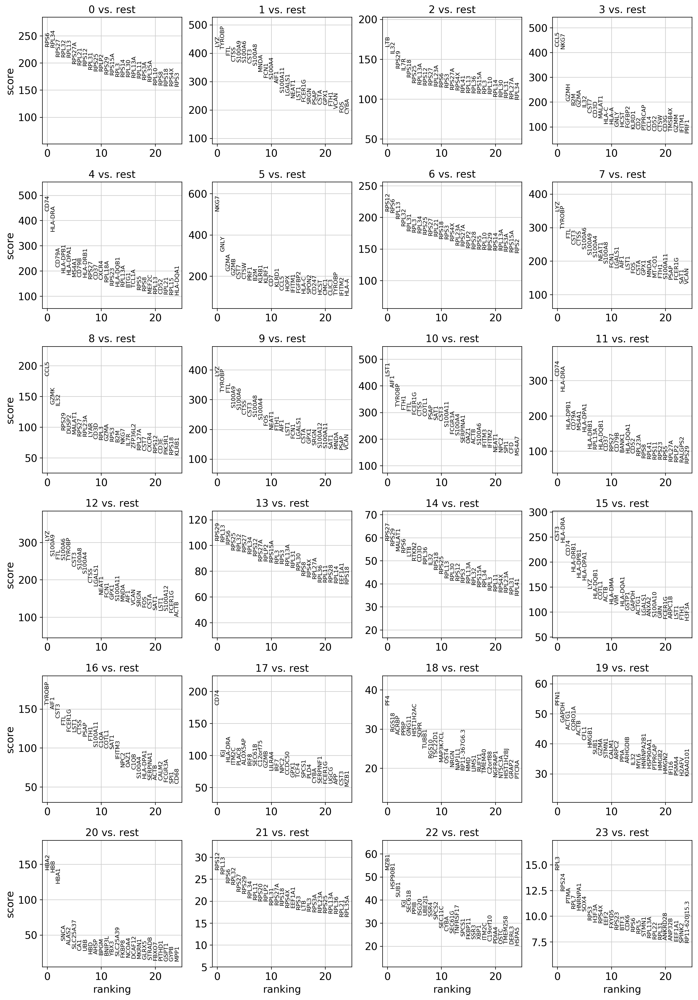

In [17]:
sc.tl.rank_genes_groups(adata, 'leiden', method='t-test')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

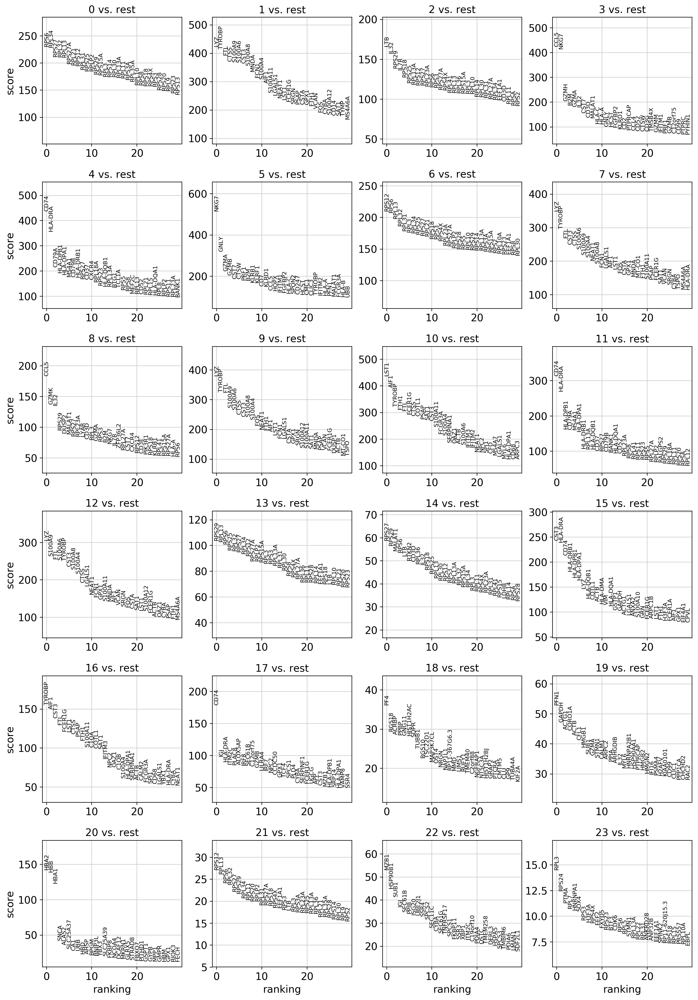

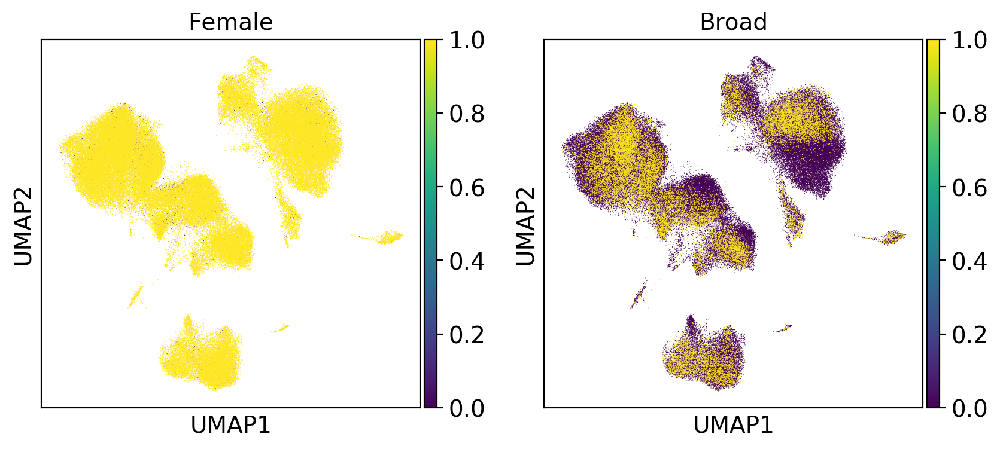

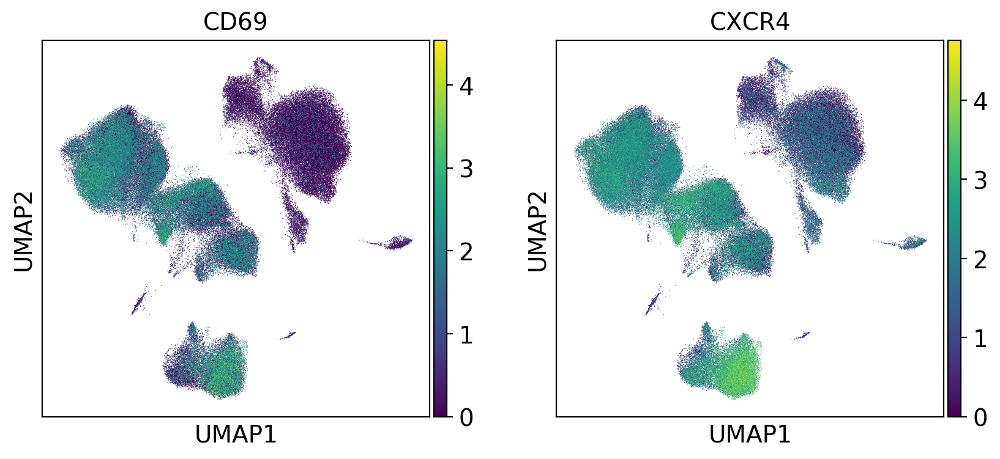

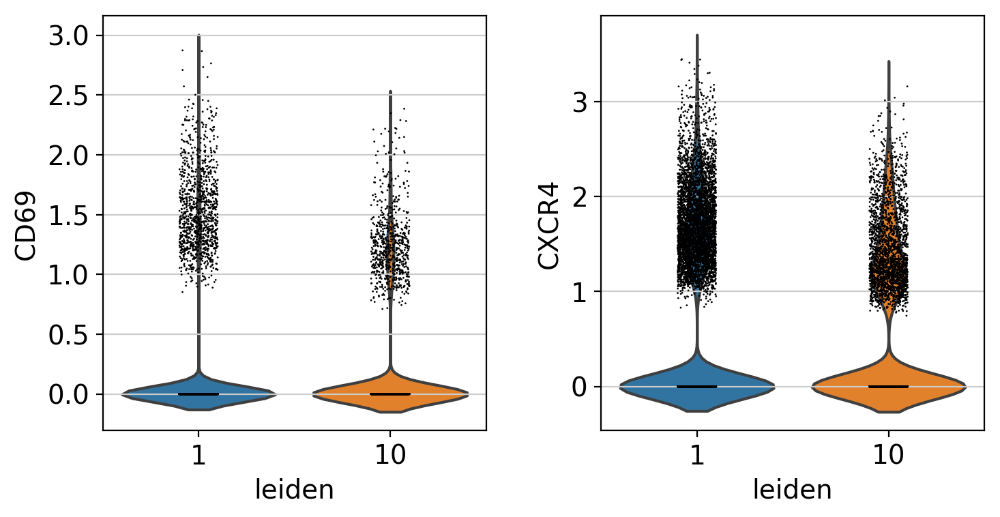

In [18]:
### sc.tl.rank_genes_groups(adata, 'leiden', method='t-test', groups=['1', '10'],reference='1')
sc.pl.rank_genes_groups(adata, n_genes=30, sharey=False)
sc.pl.umap(adata, color=['Female', 'Broad'])
sc.pl.umap(adata, color=['CD69', 'CXCR4'])
bdata = adata[adata.obs['leiden'].isin(['1', '10'])]
sc.pl.violin(bdata, keys=['CD69', 'CXCR4'], groupby='leiden')

In [19]:
adata.obs['Female'][adata.obs['Female']==3]
np.unique(adata.obs['ind_cov'][adata.obs['Female']==3].tolist())

array([], dtype=float64)

saving figure to file ./figures./umap.louvain.png


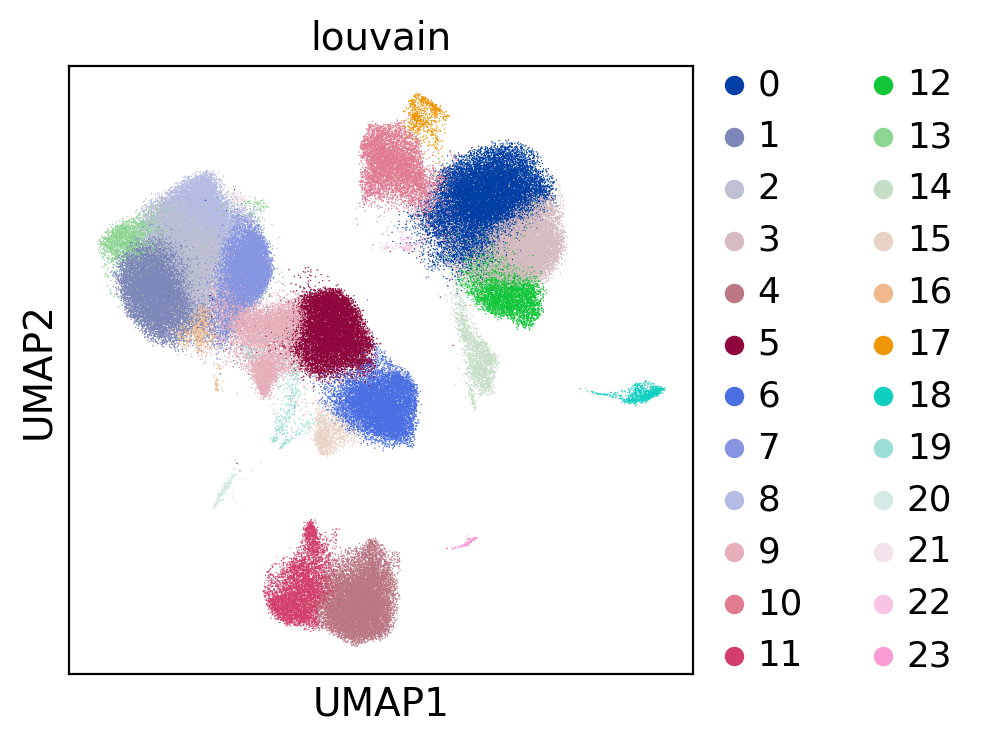

In [20]:
# sc.tl.louvain(adata, random_state=30, resolution=1.5)
sc.pl.umap(adata, color='louvain',size=1, edgecolor="none")
sc.pl.umap(adata, color='louvain', size=1, edgecolor="none", save='.louvain.png')

saving figure to file ./figures./umap.leiden.png


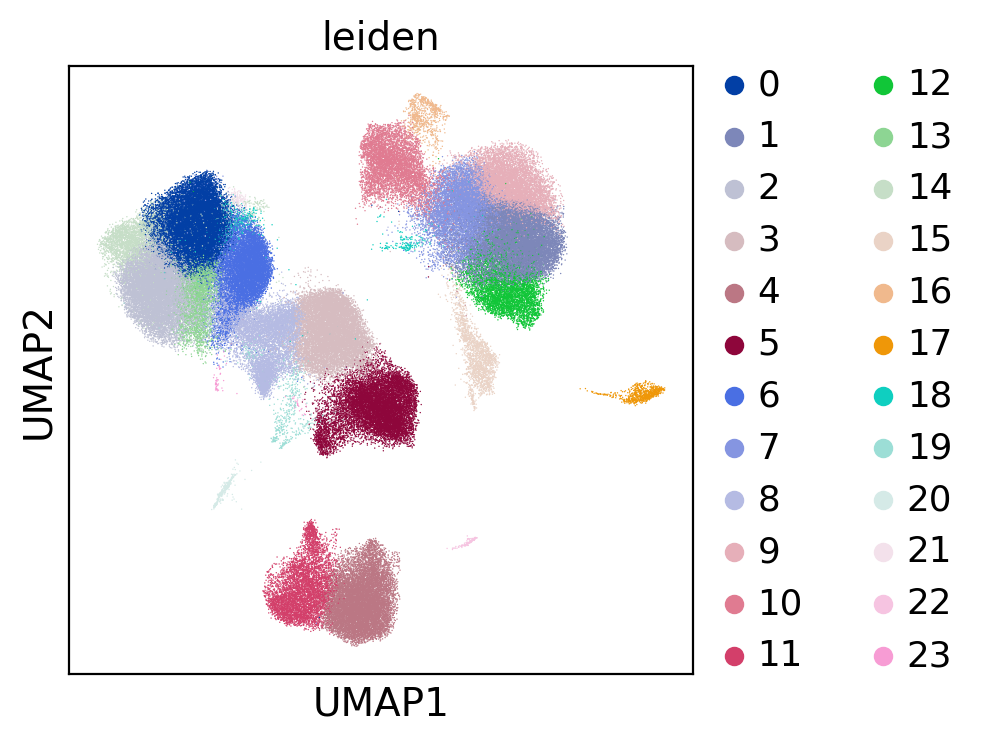

In [21]:
# sc.tl.louvain(adata, random_state=30, resolution=1.5)
sc.pl.umap(adata, color='leiden',size=1, edgecolor="none")
sc.pl.umap(adata, color='leiden', size=1, edgecolor="none", save='.leiden.png')

# Most expressed genes per leiden group

In [22]:
pd.set_option('display.max_columns', None)
unique_leiden = np.unique(adata.obs['leiden'].values)
# Compile list of top genes
GeneRanks = pd.DataFrame()
for ii in range(len(unique_leiden)):
    GeneRanks[str('leiden_' + str(ii))] = adata.var_names[np.flipud(np.argsort(np.mean(adata.X[adata.obs['leiden'] == str(ii)], axis=0)))]
GeneRanks.to_csv('FLARE_top_expression.csv')
GeneRanks.head(20)

,leiden_0,leiden_1,leiden_2,leiden_3,leiden_4,leiden_5,leiden_6,leiden_7,leiden_8,leiden_9,leiden_10,leiden_11,leiden_12,leiden_13,leiden_14,leiden_15,leiden_16,leiden_17,leiden_18,leiden_19,leiden_20,leiden_21,leiden_22,leiden_23
0,FHIT,MNDA,IL7R,GZMH,TCL1A,KLRF1,RP11-291B21.2,VCAN,GZMK,IL8,CDKN1C,MS4A1,IL1R2,IL7R,RTKN2,FCER1A,C1QB,LILRA4,ACRBP,KIAA0101,HBA1,C1QB,MZB1,PRSS57
1,PRKCQ-AS1,FCN1,TNFRSF4,CCL5,CD79A,GNLY,CD8B,CSTA,DUSP2,IL1B,FCGR3A,CD79A,CD163,PRKCQ-AS1,RP11-1399P15.1,CLEC10A,C1QA,SERPINF1,C2orf88,MKI67,ALAS2,C1QA,TNFRSF17,SPINK2
2,CCR7,CD14,IL32,NKG7,MS4A1,GZMB,CCR7,LGALS2,CCL5,S100A12,HES4,BANK1,RETN,CD3D,IL2RA,CD1C,C1QC,TPM2,HIST1H2BJ,TYMS,CA1,C1QC,IGJ,SOX4
3,TSHZ2,VCAN,ITGB1,GZMA,CD79B,PRF1,S100B,MS4A6A,LYAR,CSTA,MS4A7,RP5-887A10.1,SAP30,LEF1,TIGIT,HLA-DQA1,FCGR3A,PLD4,TMEM40,STMN1,SNCA,ADTRP,DERL3,LAPTM4B
4,ADTRP,CSTA,AQP3,CST7,LINC00926,SPON2,CD8A,CD14,IL32,G0S2,RP11-290F20.3,TNFRSF13B,S100A12,CCR7,ICA1,HLA-DQB1,MS4A7,SCT,RP11-367G6.3,TK1,HBA2,IL7R,ITM2C,MYB
5,IL7R,S100A12,CD40LG,FGFBP2,VPREB3,NKG7,IL7R,S100A12,GZMA,VCAN,RHOC,BLK,VCAN,CD3E,IKZF2,HLA-DPB1,HES4,CLEC4C,PF4,CENPF,HBD,PRKCQ-AS1,AL928768.3,EGFL7
6,MAL,CST3,GATA3,IL32,FCER2,CLIC3,LEF1,MNDA,IL7R,CD14,LYPD2,AL928768.3,CLEC4E,TRAT1,ARID5B,LMNA,LYPD2,IL3RA,RGS18,BIRC5,AHSP,LEF1,HRASLS2,PTPLA
7,LEF1,MS4A6A,CD3D,CCL4,BANK1,KLRD1,NUCB2,FCN1,KLRB1,NAMPT,LST1,RALGPS2,MNDA,MAL,CD3D,HLA-DPA1,LILRA3,ITM2C,MAP3K7CL,NUSAP1,HBB,CD3D,TNFRSF13B,ANKRD28
8,TRAT1,CTSS,CD2,KLRD1,HLA-DRA,CTSW,CD27,CST3,PIK3R1,CST3,SERPINA1,CD79B,CSTA,TSHZ2,BIRC3,HLA-DMA,RP11-290F20.3,DNASE1L3,TSC22D1,TOP2A,BPGM,MAL,IGLL5,HEMGN
9,CD3D,TYMP,TRAT1,CD3D,CD22,GZMA,PRKCQ-AS1,GPX1,KLRG1,FCN1,AIF1,AC079767.4,RNASE2,FHIT,CD27,CPVL,CDKN1C,LRRC26,HIST1H2AE,RRM2,SLC25A37,CD3E,CD38,KIAA0125


In [54]:
adata.obs['ct_cov'] = adata.obs['batch_cov'].astype("str")
# # ## do some manual cell type assignment
adata.obs['ct_cov'].loc[adata.obs.leiden == "0"] = "NaiveT4" ## good                                                                                    
adata.obs['ct_cov'].loc[adata.obs.leiden == "1"] = "cM" ## good                                                                                    
adata.obs['ct_cov'].loc[adata.obs.leiden == "2"] = "Th" ## good                                                                                     
adata.obs['ct_cov'].loc[adata.obs.leiden == "3"] = "CytoT8" ## good                                                                                    
adata.obs['ct_cov'].loc[adata.obs.leiden == "4"] = "NaiveB" ## good                                                                                    
adata.obs['ct_cov'].loc[adata.obs.leiden == "5"] = "NK" ## good                                                                                    
adata.obs['ct_cov'].loc[adata.obs.leiden == "6"] = "NaiveT8" ## good                                                                                    
adata.obs['ct_cov'].loc[adata.obs.leiden == "7"] = "cM" ## good                                                                                    
adata.obs['ct_cov'].loc[adata.obs.leiden == "8"] = "EffectorT8" ## good                                                                                    
adata.obs['ct_cov'].loc[adata.obs.leiden == "9"] = "iM" ## good                                                                                    
adata.obs['ct_cov'].loc[adata.obs.leiden == "10"] = "ncM" ## good                                                                                  
adata.obs['ct_cov'].loc[adata.obs.leiden == "11"] = "MemB" ## good                                                                                    
adata.obs['ct_cov'].loc[adata.obs.leiden == "12"] = "Macro" ## good                                                                                   
adata.obs['ct_cov'].loc[adata.obs.leiden == "13"] = "MemT4" ## good                                                                                   
adata.obs['ct_cov'].loc[adata.obs.leiden == "14"] = "TReg" ## good                                                                                  
adata.obs['ct_cov'].loc[adata.obs.leiden == "15"] = "cDC" ## good                                                                                   
adata.obs['ct_cov'].loc[adata.obs.leiden == "16"] = "ncM" ## good                                                                                   
adata.obs['ct_cov'].loc[adata.obs.leiden == "17"] = "pDC" ## good                                                                                  
adata.obs['ct_cov'].loc[adata.obs.leiden == "18"] = "MK" ## good                                                                              
adata.obs['ct_cov'].loc[adata.obs.leiden == "19"] = "ProlifT" ## good                                                                               
adata.obs['ct_cov'].loc[adata.obs.leiden == "20"] = "RBC" ## good                                                                                   
adata.obs['ct_cov'].loc[adata.obs.leiden == "21"] = "C1QT" ##
adata.obs['ct_cov'].loc[adata.obs.leiden == "22"] = "MZB1B" ## good 
adata.obs['ct_cov'].loc[adata.obs.leiden == "23"] = "Precursor" ##
adata.obs['ct_cov'] = adata.obs.ct_cov.astype('category')

/netapp/home/richardkperez/anaconda3/lib/python3.6/site-packages/pandas/core/indexing.py:190: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._setitem_with_indexer(indexer, value)


saving figure to file ./figures./umap.celltype.png


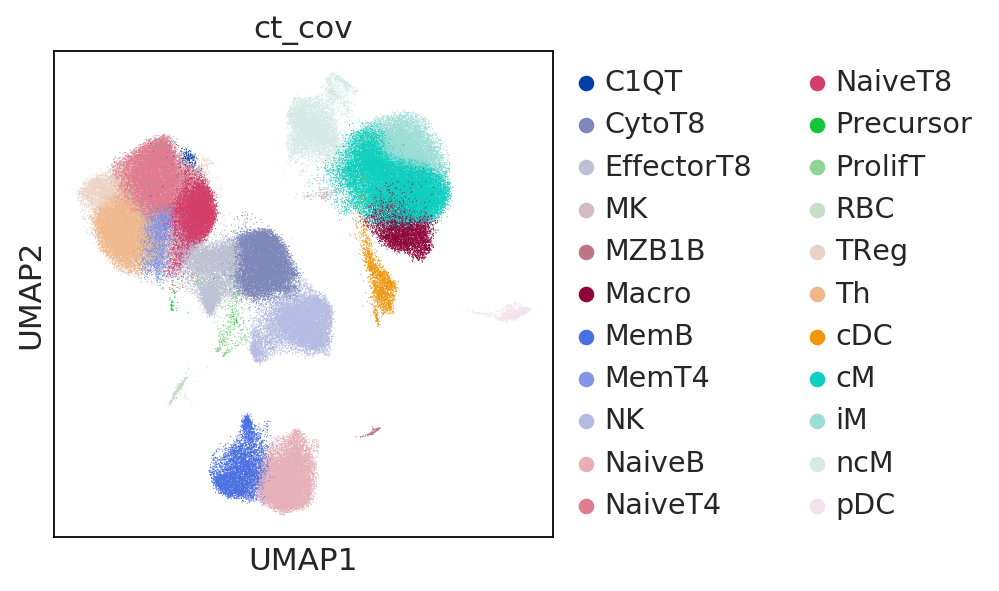

In [55]:
## Make cell type plot (Fig. 1C)
adata.uns['ct_cov_colors'] = sc.pl.palettes.vega_20_scanpy;
celltype_umap = sc.pl.umap(adata, color='ct_cov', size=1, edgecolor="none", save='.celltype.png')
celltype_umap = sc.pl.umap(adata, color='ct_cov',size=1, edgecolor="none")

In [52]:
## Plot IFN signature
ifn_genes = pd.read_csv('/ye/yelabstore/10x.lupus/batch4.analysis/ifn.lupus.crow.etal.txt', header=None)
ifn_genes = ifn_genes[0]
#sc.pl.umap(adata, color=ifn_genes, size=3)

saving figure to file ./figures./umap.platelet.png


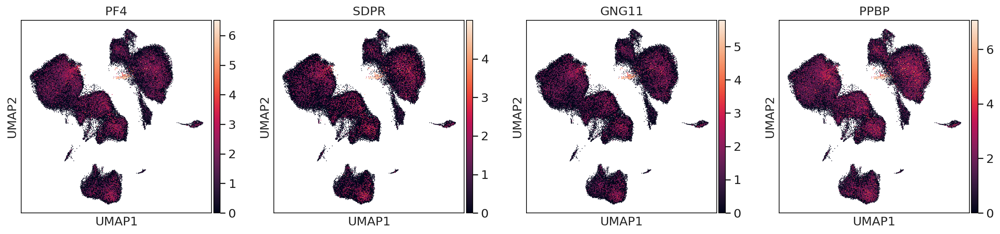

In [53]:
## platelet effect
sc.pl.umap(adata, color=["PF4", "SDPR", "GNG11", "PPBP"], size=3)
sc.pl.umap(adata, color=["PF4", "SDPR", "GNG11", "PPBP"], size=3, save='.platelet.png')

saving figure to file ./figures./umap.cycling.png


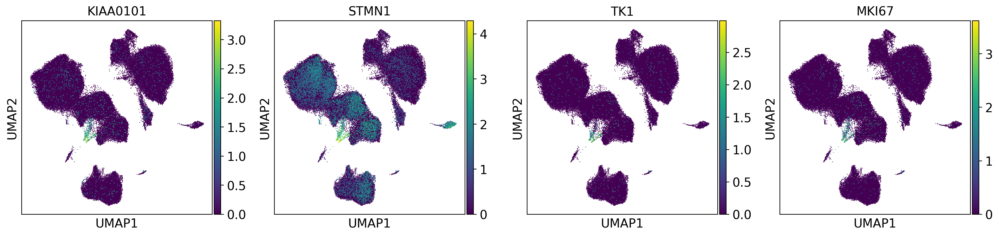

In [27]:
## cycling
sc.pl.umap(adata, color=["KIAA0101","STMN1","TK1","MKI67"], size=3)
sc.pl.umap(adata, color=["KIAA0101","STMN1","TK1","MKI67"], size=3, save='.cycling.png')

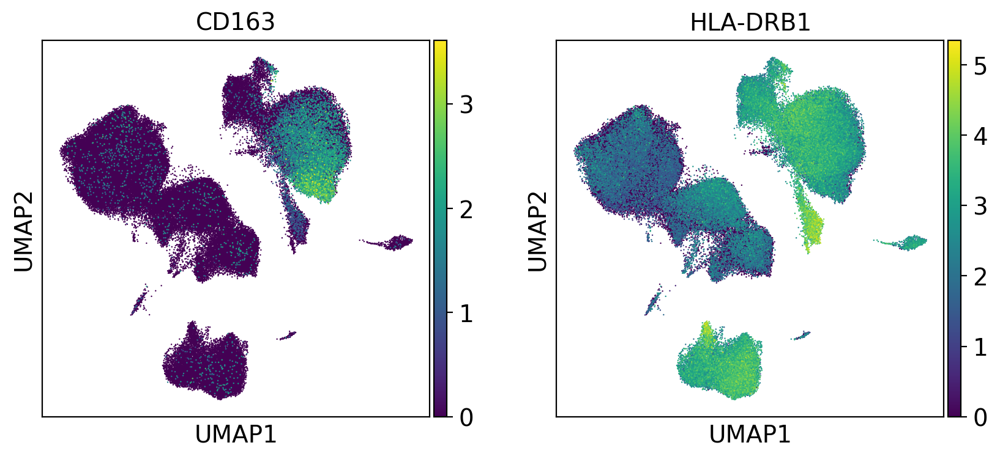

In [28]:
## MACROPHAGES
sc.pl.umap(adata, color=['CD163', 'HLA-DRB1'], size=3)

saving figure to file ./figures./umap.TNK.png


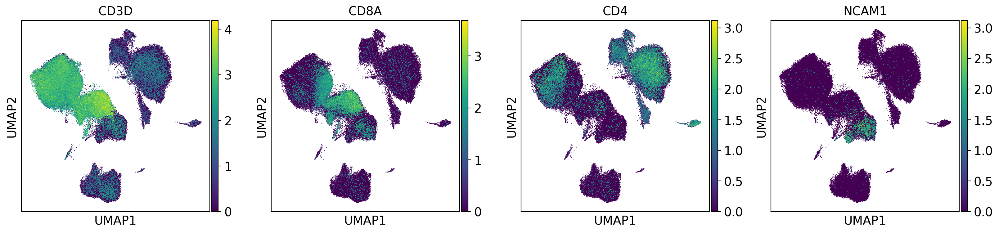

In [29]:
## CD4, CD8 and NK axis
sc.pl.umap(adata, color=["CD3D","CD8A","CD4","NCAM1"],size=3)
sc.pl.umap(adata, color=["CD3D","CD8A","CD4","NCAM1"],size=3, save=".TNK.png")

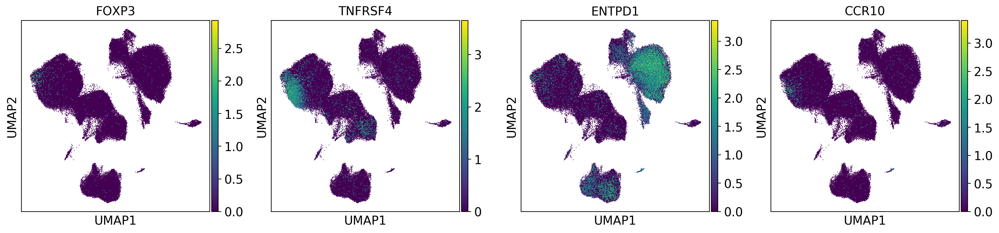

In [30]:
## treg
sc.pl.umap(adata, color=["FOXP3","TNFRSF4","ENTPD1","CCR10"],size=3)

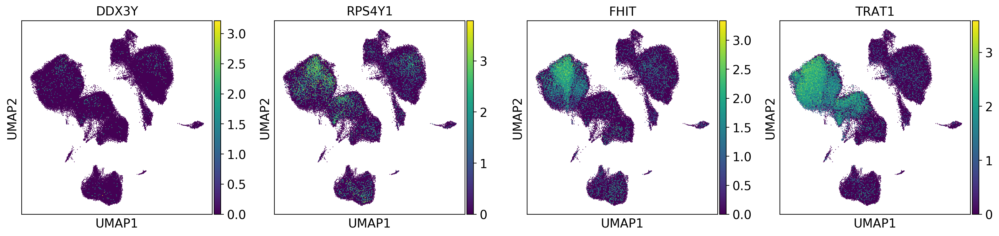

In [31]:
## y chromosome gender effect
sc.pl.umap(adata, color=["DDX3Y", "RPS4Y1", "FHIT","TRAT1"], size =3)

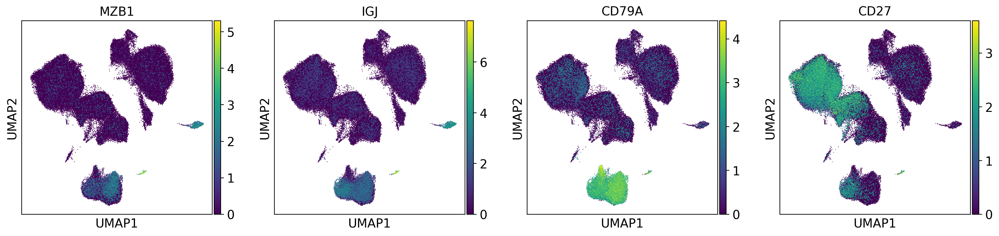

In [32]:
## b cells, plasmablasts and pdcs
sc.pl.umap(adata, color=["MZB1", "IGJ", "CD79A", 'CD27'],size=3)

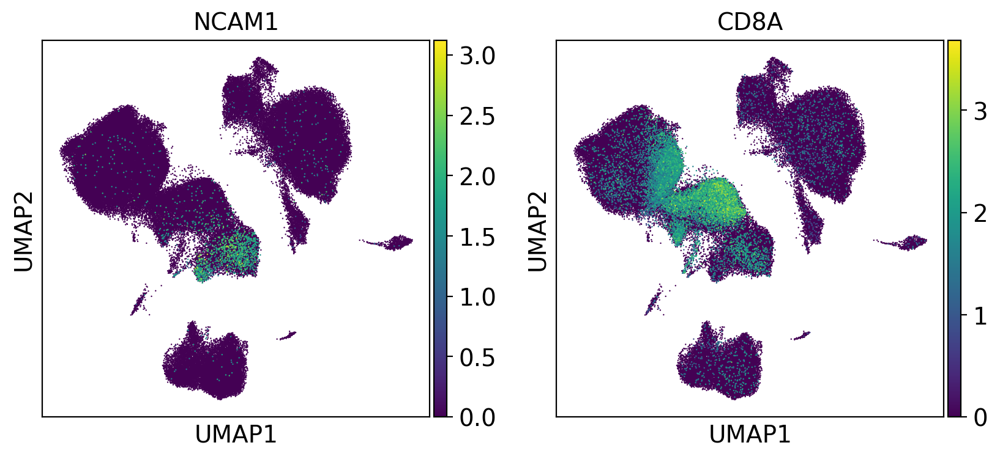

In [33]:
## NK cells
sc.pl.umap(adata, color=["NCAM1",'CD8A'],size=3)

# Figure 1D: Cell type proportion differences between case/control

## First got to compute the percentages

In [34]:
## we should be able to combine the cell type proportion estimates for the samples processed in Boston vs those processed in SF

## this neesd to be updated since right now individual 101 (1240) is treated as 4 different individuals for each pool it was run in

In [58]:
## Make proportion plots (Fig. 1D)

##adata_obs_small = adata.obs[(adata.obs.study_cov=="ImmVar") & (adata.obs.ind_cov.str.contains("IGTB")) | (~adata.obs.ind_cov.str.contains("IGTB") & (adata.obs.study_cov=="CLUES"))]
##adata_obs_small = adata.obs[(adata.obs.well.str.contains("immvar")) & (adata.obs.ind_cov.str.contains("IGTB")) | (~adata.obs.ind_cov.str.contains("IGTB") & ~adata.obs.well.str.contains("immvar"))]
adata_obs_small = adata.obs;

##ind_count = adata_obs_small.groupby(['ind_cov','study_cov','ct_cov','disease_cov','pop_cov','batch_cov'])['ct_cov'].count()
ind_count = adata_obs_small.groupby(['ind_cov','ct_cov','disease_cov','SOURCE','batch_cov'])['ct_cov'].count()
#ind_count = adata_obs_small.groupby(['ind_cov','ct_cov','disease_cov','source','batch_cov', 'CD38|CD38|j95-01|pAbO'])['ct_cov'].count()

##ind_count = adata.obs.groupby(['ind_cov','study_cov','ct_cov','disease_cov','pop_cov'])['ct_cov'].count()
##ind_count = adata.obs.groupby(['ind_cov','ct_cov','disease_cov','pop_cov'])['ct_cov'].count()

##ind_count = ind_count.reset_index(name="counts")
ind_count_sums = ind_count.groupby(['ind_cov','disease_cov','SOURCE','batch_cov']).sum()
ind_count_sums = ind_count_sums.reset_index(name="counts")

ind_perc = ind_count/ind_count.groupby(['ind_cov','disease_cov','SOURCE','batch_cov']).transform(sum)*100

ind_perc = ind_perc.reset_index(name="ct_perc")
## filter samples that have < 100 cells
##ind_perc = ind_perc[ind_perc.ind_cov.isin(ind_count_sums.ind_cov[ind_count_sums.counts > 100])]


# Statistical comparison between SLE and Healthy

In [59]:
ind_perc['disease_source_cov'] = pd.Categorical(ind_perc.apply(lambda row: row['disease_cov'] + row['SOURCE'], axis=1))

##ct_group = pd.DataFrame( {'ct_cov':['B','CD14 Monoc','CD16 Monoc', 'CD4+ T', 'CD8+ T', 'MK', 'NK', 'cDC', 'pDC','Progenitor','Proliferat'], 'ct_group':['lymph', 'mono', 'mono', 'lymph','lymph', 'mkc','lymph','dc','pdc','progen','lymph']})
ct_group = pd.DataFrame( {'ct_cov':['Precursor', 'Th', 'MZB1B', 'MemB', 'NaiveB','cM','ncM', 'iM', 'NaiveT4', 'Macro','MemT4', 'MemT8', 'CytoT8', 'NaiveT8', 'TReg', 'NK', 'ProlifT','C1QT', 'RBC', 'cDC', 'pDC'], 
                          'ct_group':['precursor','lymph', 'lymph', 'lymph', 'lymph', 'mono', 'mono', 'mono','lymph', 'mono', 'lymph', 'lymph', 'lymph','lymph', 'lymph', 'lymph', 'lymph', 'lymph', 'RBC','mono', 'mono']})
#ind_perc.ind_cov = ind_perc.ind_cov.apply(lambda x: x.split('_')[0])
#ind_count_sums.ind_cov = ind_count_sums.ind_cov.apply(lambda x: x.split('_')[0])
ind_perc = ind_perc.set_index('ct_cov').join(ct_group.set_index('ct_cov'))
ind_perc.ind_cov = ind_perc.ind_cov.astype("str")
##ind_perc.batch_cov = ind_perc.batch_cov.astype("str")
ind_perc.reset_index(inplace=True)
ind_perc.ct_cov = ind_perc.ct_cov.astype('category')
ind_perc.ct_cov = ind_perc.ct_cov.cat.reorder_categories(adata.obs.ct_cov.cat.categories.values)

print('as a proportion of total PBMC ')

for ct_i in range(len(np.unique(adata.obs.ct_cov))) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ct_perc = ind_perc.ct_perc[ind_perc.ct_cov==ct]
    disease = ind_perc.disease_cov[ind_perc.ct_cov==ct]
    disease = disease.astype("str")
    disease.values[disease!="HEALTHY"] = 0
    disease.values[disease=="HEALTHY"] = 1
    disease = sm.add_constant(disease)
    ##data = data.assign(ct_perc=ct_perc)
    print('Cell type:'+ ct)
    est=sm.OLS(ct_perc.astype(float), disease.astype(float))
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    #print(effect)
    #print(pval)
    print('Beta='+str(effect)+', pvalue='+str(pval))

as a proportion of total PBMC 
Cell type:C1QT
Beta=0.07488162297957249, pvalue=0.008313083872040276
Cell type:CytoT8
Beta=-5.138842810597604, pvalue=0.02132137661263947
Cell type:EffectorT8
Beta=4.458069024850584, pvalue=5.619430729378265e-08
Cell type:MK
Beta=0.06817717405774039, pvalue=0.3994001161498103


/netapp/home/richardkperez/anaconda3/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


Cell type:MZB1B
Beta=-0.10597849223334693, pvalue=0.056197304092926066
Cell type:Macro
Beta=-8.139531029951895, pvalue=0.018771539473030636
Cell type:MemB
Beta=1.437028916779328, pvalue=0.08852029509992188
Cell type:MemT4
Beta=2.1151296987178223, pvalue=0.0019378147389969285
Cell type:NK
Beta=0.49406076110854824, pvalue=0.7557275905274583
Cell type:NaiveB
Beta=0.2185902821379324, pvalue=0.8984561977443949
Cell type:NaiveT4
Beta=7.066813357131085, pvalue=0.0004766509065195392
Cell type:NaiveT8
Beta=-1.7300519080510552, pvalue=0.1847528281249758
Cell type:Precursor
Beta=0.006513981570601464, pvalue=0.6898843808027071
Cell type:ProlifT
Beta=-0.4842365184110762, pvalue=0.018514272632771486
Cell type:RBC
Beta=-0.10494679551177508, pvalue=0.23861502363358134
Cell type:TReg
Beta=-1.3894462543356334, pvalue=0.0035364180100896994
Cell type:Th
Beta=1.3405661477294046, pvalue=0.3099192189775399
Cell type:cDC
Beta=1.129632098806446, pvalue=1.0492141831732206e-05
Cell type:cM
Beta=-9.44055051814794

In [60]:
ind_perc_healthy_unt = ind_perc[ind_perc.disease_cov.str.contains("HEALTHY|UNT",regex=True)];
print('as a proportion of total PBMC ')

for ct_i in range(len(np.unique(adata.obs.ct_cov))) :
    ct = ind_perc_healthy_unt.ct_cov.cat.categories[ct_i]
    ct_perc = ind_perc_healthy_unt.ct_perc[ind_perc_healthy_unt.ct_cov==ct]
    disease = ind_perc_healthy_unt.disease_cov[ind_perc_healthy_unt.ct_cov==ct]
    disease = disease.astype("str")
    disease.values[disease!="HEALTHY"] = 0
    disease.values[disease=="HEALTHY"] = 1
    disease = sm.add_constant(disease)
    ##data = data.assign(ct_perc=ct_perc)
    print('Cell type:'+ ct)
    est=sm.OLS(ct_perc.astype(float), disease.astype(float))
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    #print(effect)
    #print(pval)
    print('Beta='+str(effect)+', pvalue='+str(pval))

as a proportion of total PBMC 
Cell type:C1QT
Beta=0.062367339324772265, pvalue=0.06995013581653581
Cell type:CytoT8
Beta=-6.674208047132678, pvalue=0.0009129120548919737
Cell type:EffectorT8
Beta=3.9198560485460083, pvalue=4.420290168831466e-05
Cell type:MK
Beta=-0.010584651096550747, pvalue=0.9118470186205664
Cell type:MZB1B
Beta=-0.1147825253812117, pvalue=0.0600197019805568
Cell type:Macro
Beta=-8.699470486599697, pvalue=0.0067303495067505496
Cell type:MemB
Beta=0.3634783433480137, pvalue=0.7200841063502178
Cell type:MemT4
Beta=2.4608483757602486, pvalue=0.0033222134479911148


/netapp/home/richardkperez/anaconda3/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


Cell type:NK
Beta=1.7129534134948299, pvalue=0.23178331585995332
Cell type:NaiveB
Beta=-0.3276326227251638, pvalue=0.8653932797632568
Cell type:NaiveT4
Beta=5.680546116985852, pvalue=0.02002188921909237
Cell type:NaiveT8
Beta=-2.5686169687723517, pvalue=0.08627995254627191
Cell type:Precursor
Beta=0.021034377850409347, pvalue=0.17196788634882523
Cell type:ProlifT
Beta=-0.6753681491404383, pvalue=0.007628541020638901
Cell type:RBC
Beta=-0.060936128443932855, pvalue=0.24675061963097616
Cell type:TReg
Beta=-1.7206496903960562, pvalue=0.0024031441218885633
Cell type:Th
Beta=2.674778663739507, pvalue=0.009682875811871352
Cell type:cDC
Beta=1.3982273071873745, pvalue=1.6211387419603796e-06
Cell type:cM
Beta=-6.602664320886228, pvalue=0.0650081760153595
Cell type:iM
Beta=6.493440653155133, pvalue=0.00034106612470600003
Cell type:ncM
Beta=1.8593181867509123, pvalue=0.09964265764990458
Cell type:pDC
Beta=0.6065031123496106, pvalue=5.8021548931979935e-05


## Next, let's plot the proportions

/netapp/home/richardkperez/anaconda3/lib/python3.6/site-packages/seaborn/categorical.py:3692: UserWarning: The `size` paramter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


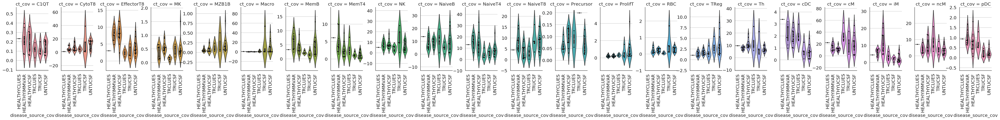

In [61]:
perc_plot = sns.catplot(x='disease_source_cov', y='ct_perc', hue='ct_cov', data=ind_perc, kind='violin', col='ct_cov', size=4, dodge=False, aspect=0.5, sharex=False, sharey=False)
perc_plot.set_xticklabels(rotation=90)
perc_plot.fig.subplots_adjust(wspace=0.4)

for ct_i in list(range(len(ind_perc.ct_cov.cat.categories))) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    sns.swarmplot(x="disease_source_cov", y="ct_perc", data=ind_perc[ind_perc.ct_cov == ct], color="0", size=3, ax=perc_plot.axes[0,ct_i])
    perc_plot.axes[0,ct_i].get_yaxis().label.set_visible(False)
    
perc_plot.savefig(figdir+"violin.ct_cov.png")
#fig,ax = plt.subplots(nrows=1,ncols=10, figsize=(20,5))
#fig.tight_layout()

# for ct_i in list(range(10)) :
#    ct = ind_perc.ct_cov.cat.categories[ct_i]
#    sns.boxplot(x="disease_cov", y="ct_perc", data=ind_perc[ind_perc.ct_cov == ct], color=sc.pl.palettes.vega_20_scanpy[ct_i], ax=ax[ct_i])
#    sns.swarmplot(x="disease_cov", y="ct_perc", data=ind_perc[ind_perc.ct_cov == ct], color="0", size=3, ax=ax[ct_i])

/netapp/home/richardkperez/anaconda3/lib/python3.6/site-packages/seaborn/categorical.py:3692: UserWarning: The `size` paramter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


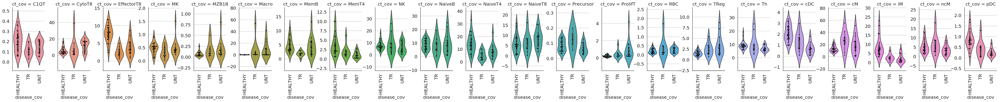

In [62]:
perc_plot = sns.catplot(x='disease_cov', y='ct_perc', hue='ct_cov', data=ind_perc, kind='violin', col='ct_cov', size=4, dodge=False, aspect=0.5, sharex=False, sharey=False)
perc_plot.set_xticklabels(rotation=90)
perc_plot.fig.subplots_adjust(wspace=0.4)

for ct_i in list(range(len(ind_perc.ct_cov.cat.categories))) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    sns.swarmplot(x="disease_cov", y="ct_perc", data=ind_perc[ind_perc.ct_cov == ct], color="0", size=3, ax=perc_plot.axes[0,ct_i])
    perc_plot.axes[0,ct_i].get_yaxis().label.set_visible(False)
    
perc_plot.savefig(figdir+"violin.ct_cov.png")
#fig,ax = plt.subplots(nrows=1,ncols=10, figsize=(20,5))
#fig.tight_layout()

# for ct_i in list(range(10)) :
#    ct = ind_perc.ct_cov.cat.categories[ct_i]
#    sns.boxplot(x="disease_cov", y="ct_perc", data=ind_perc[ind_perc.ct_cov == ct], color=sc.pl.palettes.vega_20_scanpy[ct_i], ax=ax[ct_i])
#    sns.swarmplot(x="disease_cov", y="ct_perc", data=ind_perc[ind_perc.ct_cov == ct], color="0", size=3, ax=ax[ct_i])

# Lymphocyte and Monocyte groups

/netapp/home/richardkperez/anaconda3/lib/python3.6/site-packages/pandas/core/indexing.py:190: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._setitem_with_indexer(indexer, value)
/netapp/home/richardkperez/anaconda3/lib/python3.6/site-packages/seaborn/categorical.py:3692: UserWarning: The `size` paramter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


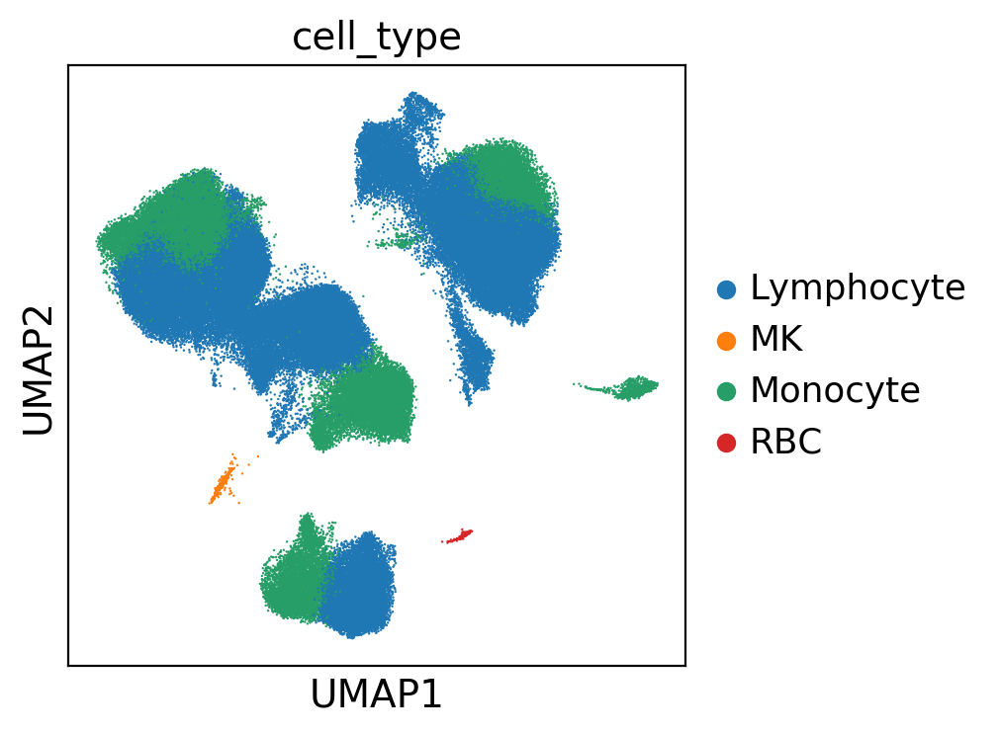

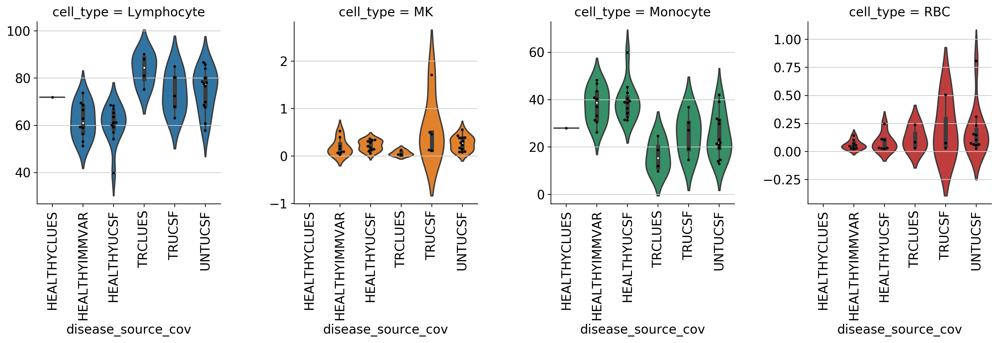

In [40]:
adata.obs['cell_type'] = adata.obs['batch_cov'].astype("str")
# # ## do some manual cell type assignment
adata.obs['cell_type'].loc[adata.obs.leiden == "0"] = "Monocyte" ## good                                                                                    
adata.obs['cell_type'].loc[adata.obs.leiden == "1"] = "Lymphocyte" ## good                                                                                    
adata.obs['cell_type'].loc[adata.obs.leiden == "2"] = "Lymphocyte" ## good                                                                                     
adata.obs['cell_type'].loc[adata.obs.leiden == "3"] = "Lymphocyte" ## good                                                                                    
adata.obs['cell_type'].loc[adata.obs.leiden == "4"] = "Lymphocyte" ## good                                                                                    
adata.obs['cell_type'].loc[adata.obs.leiden == "5"] = "Monocyte" ## good                                                                                    
adata.obs['cell_type'].loc[adata.obs.leiden == "6"] = "Lymphocyte" ## good                                                                                    
adata.obs['cell_type'].loc[adata.obs.leiden == "7"] = "Lymphocyte" ## good                                                                                    
adata.obs['cell_type'].loc[adata.obs.leiden == "8"] = "Lymphocyte" ## good                                                                                    
adata.obs['cell_type'].loc[adata.obs.leiden == "9"] = "Monocyte" ## good                                                                                    
adata.obs['cell_type'].loc[adata.obs.leiden == "10"] = "Lymphocyte" ## good                                                                                  
adata.obs['cell_type'].loc[adata.obs.leiden == "11"] = "Monocyte" ## good                                                                                    
adata.obs['cell_type'].loc[adata.obs.leiden == "12"] = "Lymphocyte" ## good                                                                                   
adata.obs['cell_type'].loc[adata.obs.leiden == "13"] = "Lymphocyte" ## good                                                                                   
adata.obs['cell_type'].loc[adata.obs.leiden == "14"] = "Monocyte" ## good                                                                                  
adata.obs['cell_type'].loc[adata.obs.leiden == "15"] = "Lymphocyte" ## good                                                                                   
adata.obs['cell_type'].loc[adata.obs.leiden == "16"] = "Lymphocyte" ## good                                                                                   
adata.obs['cell_type'].loc[adata.obs.leiden == "17"] = "Monocyte" ## good                                                                                  
adata.obs['cell_type'].loc[adata.obs.leiden == "18"] = "Monocyte" ## good                                                                              
adata.obs['cell_type'].loc[adata.obs.leiden == "19"] = "Lymphocyte" ## good                                                                               
adata.obs['cell_type'].loc[adata.obs.leiden == "20"] = "MK" ## good                                                                                   
adata.obs['cell_type'].loc[adata.obs.leiden == "21"] = "Lymphocyte" ##
adata.obs['cell_type'].loc[adata.obs.leiden == "22"] = "RBC" ## good 
adata.obs['cell_type'].loc[adata.obs.leiden == "23"] = "Lymphocyte" ##
adata.obs['cell_type'].loc[adata.obs.leiden == "24"] = "Lymphocyte" ##  
adata.obs['cell_type'] = adata.obs.cell_type.astype('category')
sc.pl.umap(adata, color='cell_type',size=3)

adata_obs_small = adata.obs;
ind_count = adata_obs_small.groupby(['ind_cov','cell_type','disease_cov','SOURCE','batch_cov'])['cell_type'].count()
ind_count_sums = ind_count.groupby(['ind_cov','disease_cov','SOURCE','batch_cov']).sum()
ind_count_sums = ind_count_sums.reset_index(name="counts")
ind_perc = ind_count/ind_count.groupby(['ind_cov','disease_cov','SOURCE','batch_cov']).transform(sum)*100
ind_perc = ind_perc.reset_index(name="ct_perc")
ind_perc['disease_source_cov'] = pd.Categorical(ind_perc.apply(lambda row: row['disease_cov'] + row['SOURCE'], axis=1))
perc_plot = sns.catplot(x='disease_source_cov', y='ct_perc', hue='cell_type', data=ind_perc, kind='violin', col='cell_type', size=4, dodge=False, aspect=1, sharex=False, sharey=False)
perc_plot.set_xticklabels(rotation=90)
perc_plot.fig.subplots_adjust(wspace=0.4)

for ct_i in list(range(len(ind_perc.cell_type.cat.categories))) :
    ct = ind_perc.cell_type.cat.categories[ct_i]
    sns.swarmplot(x="disease_source_cov", y="ct_perc", data=ind_perc[ind_perc.cell_type == ct], color="0", size=3, ax=perc_plot.axes[0,ct_i])
    perc_plot.axes[0,ct_i].get_yaxis().label.set_visible(False)
    
perc_plot.savefig(figdir+"violin.cell_type.png")

# 1804_1804 is HEALTHY CLUES and has 855 cells
# Flare015 has 2.5% Monocytes

In [41]:
print(ind_perc[ind_perc.cell_type=='Monocyte'][ind_perc.disease_source_cov=='UNTUCSF'])
print(ind_perc[ind_perc.cell_type=='Monocyte'][ind_perc.disease_source_cov=='TRUCSF'])
#print(ind_perc[ind_perc.ind_cov=='FLARE015'])
#adata_obs_small[adata_obs_small.ind_cov=='FLARE015'].groupby(['ind_cov','cell_type','disease_cov','SOURCE','batch_cov'])['cell_type'].count()


     ind_cov cell_type disease_cov SOURCE batch_cov    ct_perc  \
21      1772  Monocyte         UNT   UCSF         4  29.866117   
36  FLARE004  Monocyte         UNT   UCSF         3  14.588592   
40  FLARE005  Monocyte         UNT   UCSF         3  20.839065   
44  FLARE006  Monocyte         UNT   UCSF         3  21.401460   
48  FLARE007  Monocyte         UNT   UCSF         3  31.957344   
55  FLARE009  Monocyte         UNT   UCSF         3  21.891892   
63  FLARE011  Monocyte         UNT   UCSF         4  13.966480   
70  FLARE013  Monocyte         UNT   UCSF         4  39.046046   
75  FLARE014  Monocyte         UNT   UCSF         3  19.576993   
79  FLARE015  Monocyte         UNT   UCSF         3  42.031687   
86  FLARE016  Monocyte         UNT   UCSF         4  23.140296   
90  FLARE017  Monocyte         UNT   UCSF         4  12.917023   
93  FLARE020  Monocyte         UNT   UCSF         4  31.298557   

   disease_source_cov  
21            UNTUCSF  
36            UNTUCSF  
40 

/netapp/home/richardkperez/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  """Entry point for launching an IPython kernel.
/netapp/home/richardkperez/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  


# Feature plots for Untreated Treated pairs

FLARE004
FLARE009
FLARE011
FLARE013
FLARE016


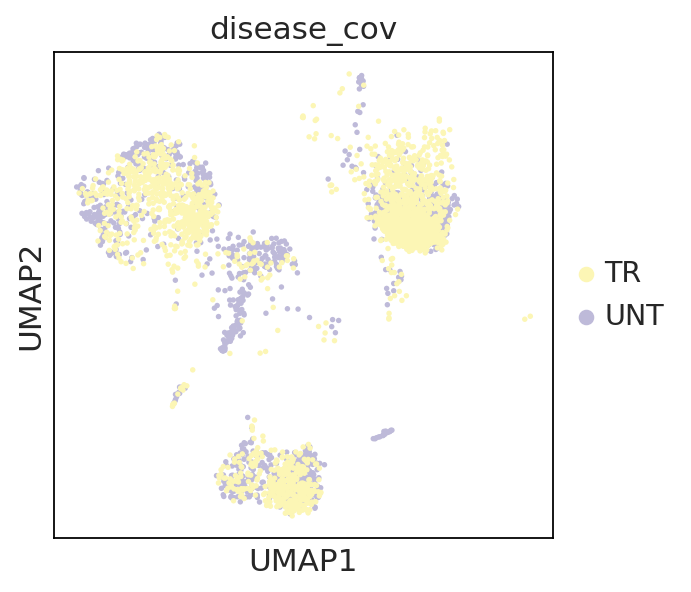

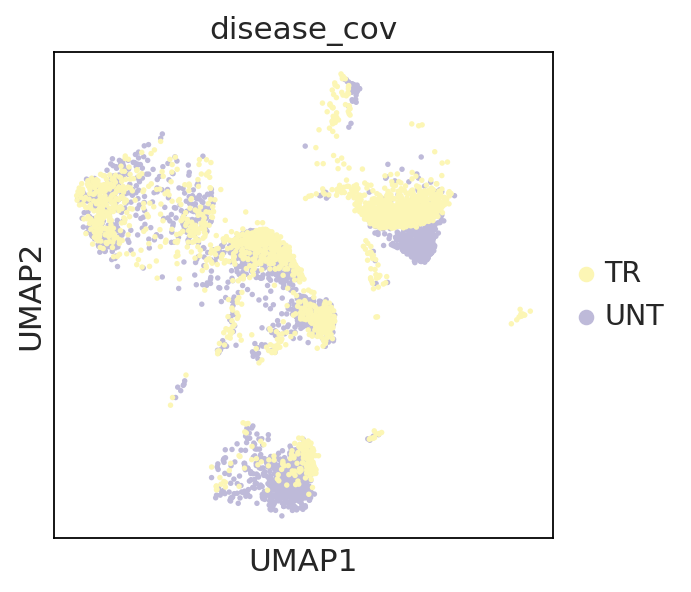

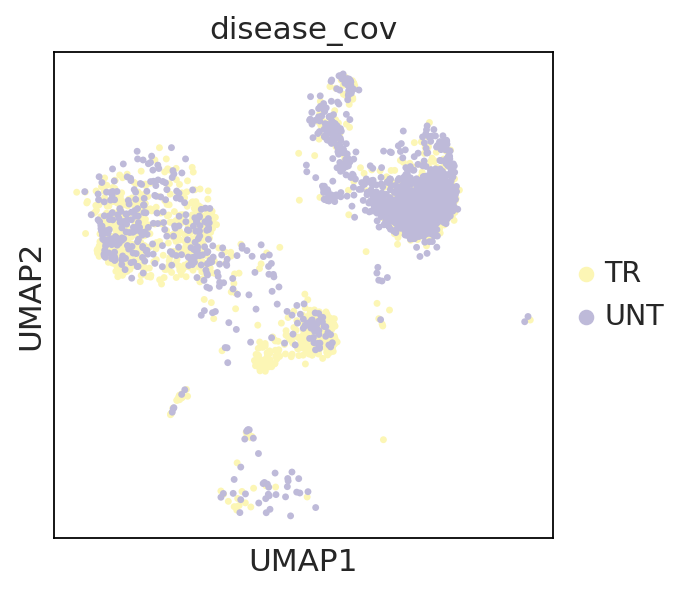

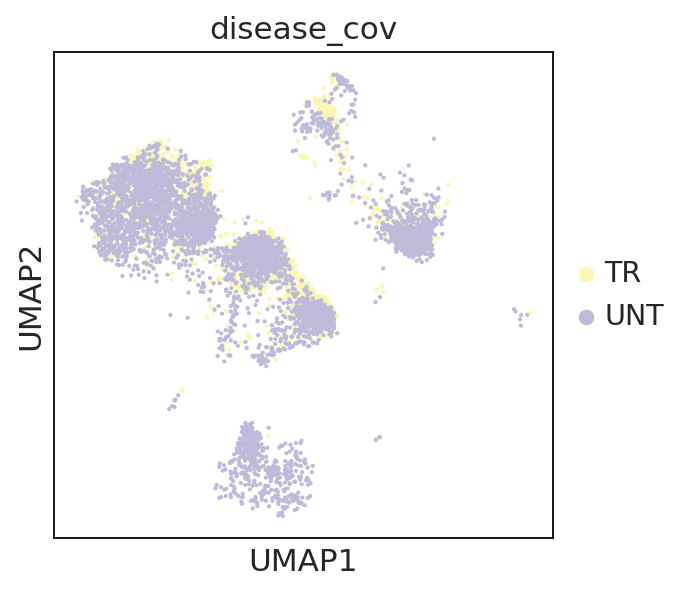

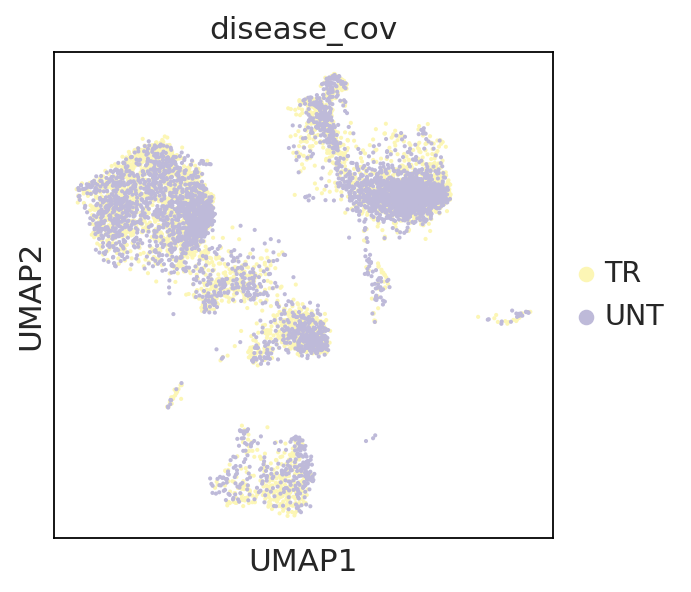

In [63]:
pairs = ['FLARE004', 'FLARE009', 'FLARE011', 'FLARE013', 'FLARE016']

for pair in pairs:
    bdata = adata[adata.obs['ind_cov']==pair]
    print(pair)
    sc.pl.umap(bdata, color='disease_cov')
    plt.show()

# Feature plot antibody expression

Ab keys
['CD38|CD38|j95-01|pAbO', 'CD95|FAS|j95-02|pAbO', 'CD28|CD28|j95-07|pAbO', 'CD27|CD27|j95-08|pAbO', 'CD197|CCR7|j95-09|pAbO', 'CD19|CD19|j95-10|pAbO', 'CD161|KLRB1|j95-11|pAbO', 'CD183|CXCR3|j95-12|pAbO', 'CD4|CD4|j95-14|pAbO', 'CD3|CD3E|j95-16|pAbO', 'CD196|CCR6|j95-17|pAbO', 'HLA-DR|CD74|j95-18|pAbO', 'CD45RO|PTPRC|j95-19|pAbO', 'CD14|CD14|j95-20|pAbO', 'CD194|CCR4|j95-21|pAbO', 'CD185|CXCR5|j95-22|pAbO', 'CD25|IL2RA|j95-24|pAbO', 'CD8|CD8A|j95-25|pAbO', 'CD127|IL7R|j95-27|pAbO', 'CD45RA|PTPRC|j95-28|pAbO']


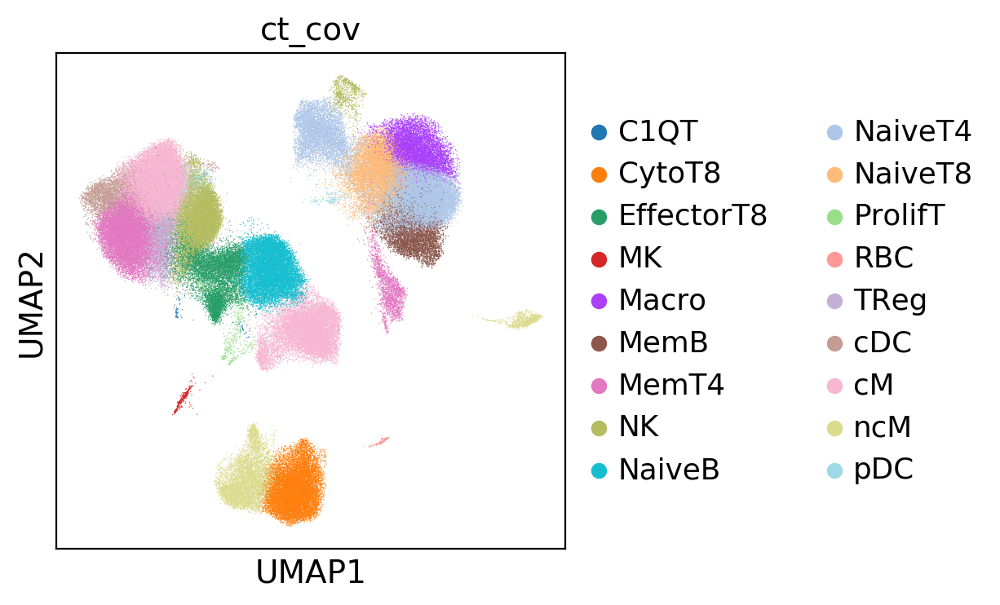

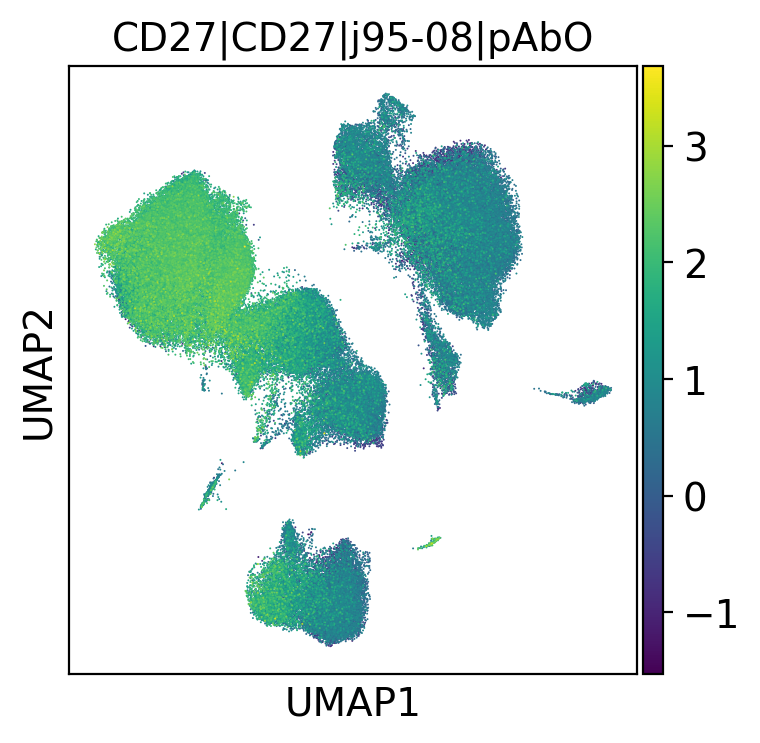

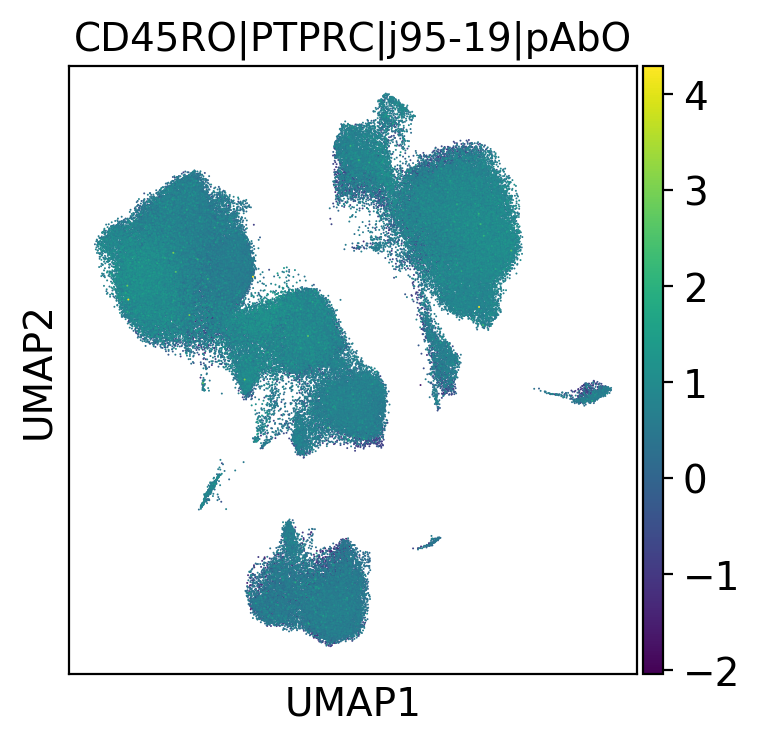

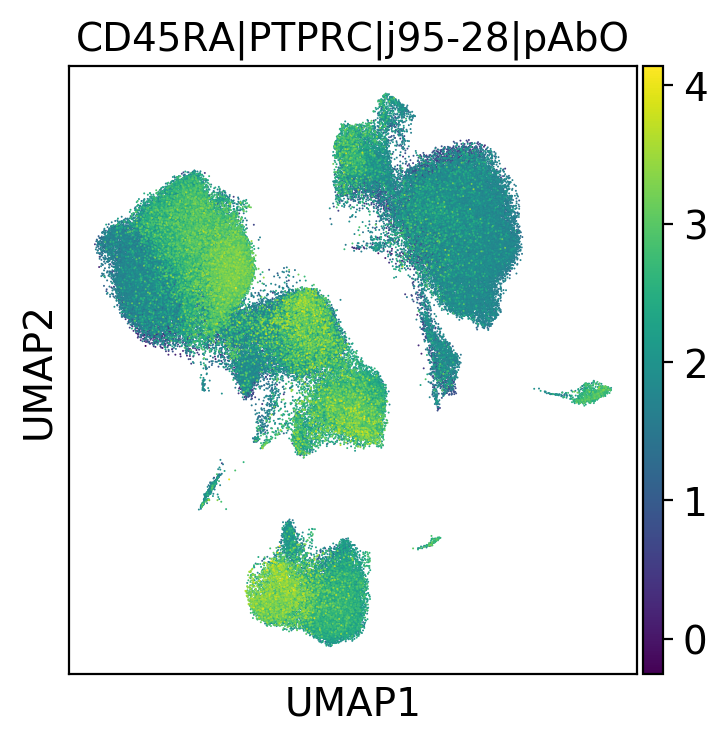

In [43]:
adata_obs_small = adata.obs;
keys = adata_obs_small.keys().tolist()
antibodykeys = [key for key in keys if 'pAbO' in key]
sc.pl.umap(adata,color='ct_cov')
print('Ab keys')
print(antibodykeys)

for key in antibodykeys:
    if key == 'CD45RA|PTPRC|j95-28|pAbO':
        sc.pl.umap(adata, color=key,size=2)
    if key == 'CD45RO|PTPRC|j95-19|pAbO':
        sc.pl.umap(adata, color=key,size=2)
    if key == 'CD27|CD27|j95-08|pAbO':
        sc.pl.umap(adata, color=key,size=2)

# Trajectory between Naive CD4 and Activated CD4

Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
AnnData object with n_obs × n_vars = 20285 × 1174 
    obs: 'SOURCE', 'TR_UNT', 'batch_cov', 'ind_cov', 'well', 'Female', 'Broad', 'CD38|CD38|j95-01|pAbO', 'CD95|FAS|j95-02|pAbO', 'CD28|CD28|j95-07|pAbO', 'CD27|CD27|j95-08|pAbO', 'CD197|CCR7|j95-09|pAbO', 'CD19|CD19|j95-10|pAbO', 'CD161|KLRB1|j95-11|pAbO', 'CD183|CXCR3|j95-12|pAbO', 'CD4|CD4|j95-14|pAbO', 'CD3|CD3E|j95-16|pAbO', 'CD196|CCR6|j95-17|pAbO', 'HLA-DR|CD74|j95-18|pAbO', 'CD45RO|PTPRC|j95-19|pAbO', 'CD14|CD14|j95-20|pAbO', 'CD194|CCR4|j95-21|pAbO', 'CD185|CXCR5|j95-22|pAbO', 'CD25|IL2RA|j95-24|pAbO', 'CD8|CD8A|j95-25|pAbO', 'CD127|IL7R|j95-27|pAbO', 'CD45RA|PTPRC|j95-28|pAbO', 'disease_cov', 'percent_mito', 'n_counts', 'n_genes', 'PF4', 'SDPR', 'GNG11', 'PPBP', 'PC3', 'PC16', 'louvain', 'leiden', 'c

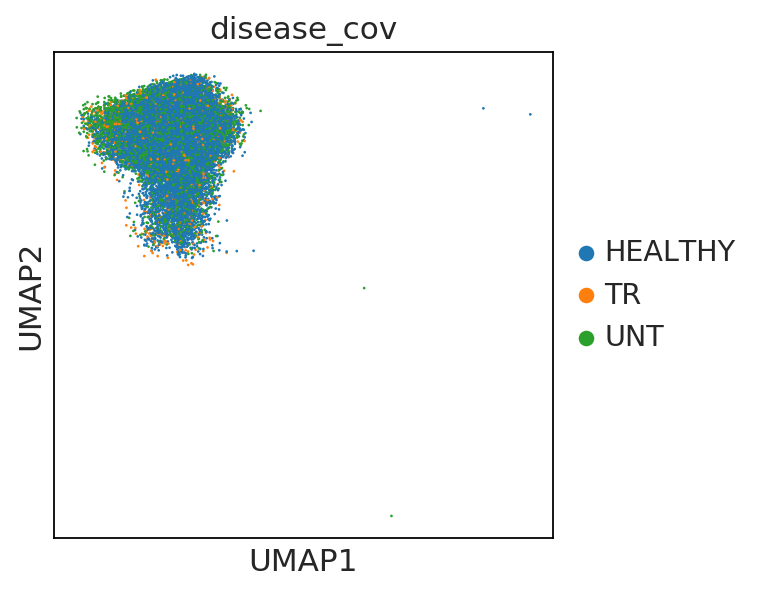

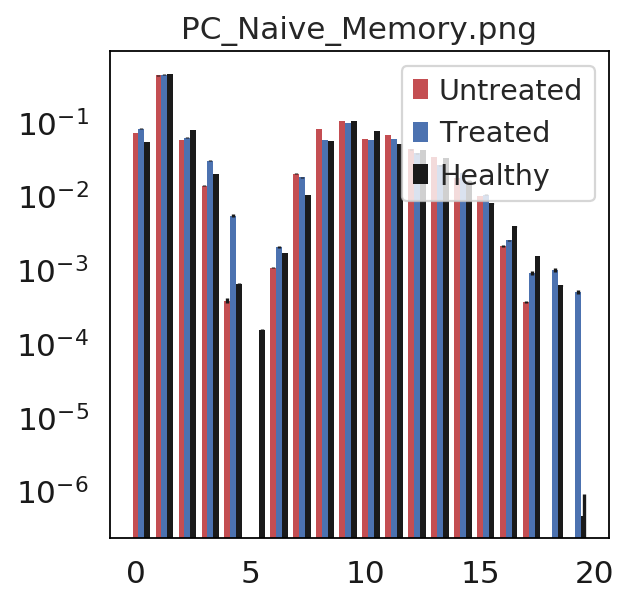

In [64]:
sns.set(font_scale=1.25)
sc.settings.set_figure_params(dpi_save=250, format='png', transparent=True)
color_map = [
    '#1f77b4', '#ff7f0e', '#2ca02c', '#d62728',
    '#9467bd', '#8c564b', '#e377c2',
    '#bcbd22', '#17becf',
    '#aec7e8', '#ffbb78', '#98df8a', '#ff9896',
    '#c5b0d5', '#c49c94', '#f7b6d2',
    '#dbdb8d', '#9edae5',
    '#ad494a', '#8c6d31']
n_bins = 20
# Keep only memory and naive CD4s
bdata = adata[adata.obs['ct_cov'].isin(['MemT4', 'NaiveT4'])]
genes = bdata.var_names[bdata.var_names.isin(['CCR7', 'IL7R', 'TNFRSF4'])].tolist()
#adata = adata[:, genes].X
# Order cells
PC = np.asarray(sc.pp.pca(bdata[:, genes].X, n_comps=1, copy=True)).reshape(-1,)
bdata.obs['PC_pseudotime'] = list(PC)
print(bdata)
sc.pl.umap(bdata, color='disease_cov', palette=color_map, show=True)
sc.pl.umap(bdata, color='PC_pseudotime', palette=color_map, show=True, save='T_Naive2Memory_pseudotime.png')
vals = np.asarray(bdata.obs['PC_pseudotime'].values.tolist())
# For Healthy
ind_healthy = bdata.obs['ind_cov'][bdata.obs['disease_cov']=='HEALTHY'].tolist()
for ind in ind_healthy:
    if ind == ind_healthy[0]:
        # pseudotime values for healthy
        healthynum = np.histogram(np.asarray(bdata.obs['PC_pseudotime'][bdata.obs['ind_cov']==ind].values.tolist()), bins=n_bins, range=(np.min(vals),np.max(vals)))[0].reshape(-1,1)
        healthynum = healthynum/np.sum(healthynum)
    else:
        # pseudotime values for healthy
        healthynum0 = np.histogram(np.asarray(bdata.obs['PC_pseudotime'][bdata.obs['ind_cov']==ind].values.tolist()), bins=n_bins, range=(np.min(vals),np.max(vals)))[0].reshape(-1,1)
        healthynum0 = healthynum0/np.sum(healthynum0)
        healthynum = np.concatenate((healthynum, healthynum0),axis=1)
healthyall = np.asarray(bdata.obs['PC_pseudotime'][bdata.obs['ind_cov'].isin(ind_healthy)].values.tolist())

# For UNTREATED
ind_FLARE = bdata.obs['ind_cov'][bdata.obs['disease_cov'].isin(['UNT'])].tolist()
for ind in ind_FLARE:
    if ind == ind_FLARE[0]:
        # pseudotime values for healthy
        FLAREnum = np.histogram(np.asarray(bdata.obs['PC_pseudotime'][bdata.obs['ind_cov']==ind].values.tolist()), bins=n_bins, range=(np.min(vals),np.max(vals)))[0].reshape(-1,1)
        FLAREnum = FLAREnum/np.sum(FLAREnum)
    else:
        # pseudotime values for healthy
        FLAREnum0 = np.histogram(np.asarray(bdata.obs['PC_pseudotime'][bdata.obs['ind_cov']==ind].values.tolist()), bins=n_bins, range=(np.min(vals),np.max(vals)))[0].reshape(-1,1)
        FLAREnum0 = FLAREnum0/np.sum(FLAREnum0)
        FLAREnum = np.concatenate((FLAREnum, FLAREnum0),axis=1)
FLAREall = np.asarray(bdata.obs['PC_pseudotime'][bdata.obs['ind_cov'].isin(ind_FLARE)].values.tolist())
    
# For TREATED
ind_TREATED = bdata.obs['ind_cov'][bdata.obs['disease_cov'].isin(['TR'])].tolist()
for ind in ind_TREATED:
    if ind == ind_TREATED[0]:
        # pseudotime values for healthy
        TREATEDnum = np.histogram(np.asarray(bdata.obs['PC_pseudotime'][bdata.obs['ind_cov']==ind].values.tolist()), bins=n_bins, range=(np.min(vals),np.max(vals)))[0].reshape(-1,1)
        TREATEDnum = TREATEDnum/np.sum(TREATEDnum)
    else:
        # pseudotime values for healthy
        TREATEDnum0 = np.histogram(np.asarray(bdata.obs['PC_pseudotime'][bdata.obs['ind_cov']==ind].values.tolist()), bins=n_bins, range=(np.min(vals),np.max(vals)))[0].reshape(-1,1)
        TREATEDnum0 = TREATEDnum0/np.sum(TREATEDnum0)
        TREATEDnum = np.concatenate((TREATEDnum, TREATEDnum0),axis=1)
TREATEDall = np.asarray(bdata.obs['PC_pseudotime'][bdata.obs['ind_cov'].isin(ind_TREATED)].values.tolist())

fig, ax = plt.subplots()
FLAREstd = stats.sem(FLAREnum, axis=1)
FLAREnum = np.mean(FLAREnum, axis=1)
TREATEDstd = stats.sem(TREATEDnum, axis=1)
TREATEDnum = np.mean(TREATEDnum, axis=1)
healthynumstd = stats.sem(healthynum, axis=1)
healthynum = np.mean(healthynum, axis=1)
ind = np.arange(n_bins)
width = 0.25
# Box plots
p1 = ax.bar(ind, FLAREnum, width, yerr= FLAREstd, color='r', bottom=0, edgecolor = "none", label='Untreated')
p1 = ax.bar(ind+width, TREATEDnum, width, yerr=TREATEDstd, color='b', bottom=0, edgecolor = "none", label='Treated')
p1 = ax.bar(ind+width*2, healthynum, width, yerr=healthynumstd, color='k', bottom=0, edgecolor = "none", label='Healthy')
# Kernal Density -does not look too good
#p1 = sns.kdeplot(FLAREall, color='r', label='Untreated')
#p1 = sns.kdeplot(TREATEDall, color='b', label='Treated')
#p1 = sns.kdeplot(healthyall, color="k", label='Healthy')
ax.set_title(str(str('PC_Naive_Memory') + '.png'))
ax.legend()
ax = plt.gca()
ax.grid(False)
ax.set_yscale('log')
plt.savefig(str(str('PC_Naive_Memory') + '.png'))
plt.show()

# DPT for Naive to Memory (Poor result!)

computing Diffusion Pseudotime using n_dcs=10
    finished (0:00:00.00)


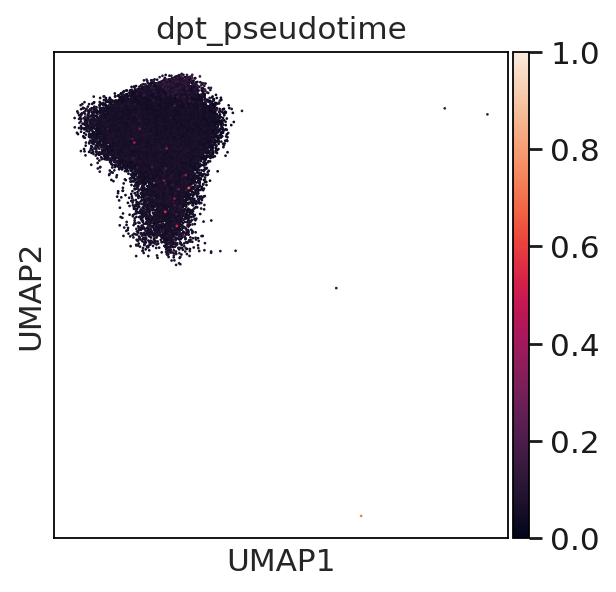

In [65]:
sns.set(font_scale=1.25)
sc.settings.set_figure_params(dpi_save=250, format='png', transparent=True)
color_map = [
    '#1f77b4', '#ff7f0e', '#2ca02c', '#d62728',
    '#9467bd', '#8c564b', '#e377c2',
    '#bcbd22', '#17becf',
    '#aec7e8', '#ffbb78', '#98df8a', '#ff9896',
    '#c5b0d5', '#c49c94', '#f7b6d2',
    '#dbdb8d', '#9edae5',
    '#ad494a', '#8c6d31']
n_bins = 20
# Keep only memory and naive CD4s
bdata = adata[adata.obs['ct_cov'].isin(['MemT4', 'NaiveT4'])]
bdata.uns['iroot'] = np.flatnonzero(adata.obs['ct_cov'] == 'NaiveT4')[0]
sc.tl.dpt(bdata)
sc.pl.umap(bdata, color='dpt_pseudotime', palette=color_map, show=True)

# 2D trajectory for Monocytes 

AnnData object with n_obs × n_vars = 137936 × 1174 
    obs: 'SOURCE', 'TR_UNT', 'batch_cov', 'ind_cov', 'well', 'Female', 'Broad', 'CD38|CD38|j95-01|pAbO', 'CD95|FAS|j95-02|pAbO', 'CD28|CD28|j95-07|pAbO', 'CD27|CD27|j95-08|pAbO', 'CD197|CCR7|j95-09|pAbO', 'CD19|CD19|j95-10|pAbO', 'CD161|KLRB1|j95-11|pAbO', 'CD183|CXCR3|j95-12|pAbO', 'CD4|CD4|j95-14|pAbO', 'CD3|CD3E|j95-16|pAbO', 'CD196|CCR6|j95-17|pAbO', 'HLA-DR|CD74|j95-18|pAbO', 'CD45RO|PTPRC|j95-19|pAbO', 'CD14|CD14|j95-20|pAbO', 'CD194|CCR4|j95-21|pAbO', 'CD185|CXCR5|j95-22|pAbO', 'CD25|IL2RA|j95-24|pAbO', 'CD8|CD8A|j95-25|pAbO', 'CD127|IL7R|j95-27|pAbO', 'CD45RA|PTPRC|j95-28|pAbO', 'disease_cov', 'percent_mito', 'n_counts', 'n_genes', 'PF4', 'SDPR', 'GNG11', 'PPBP', 'PC3', 'PC16', 'louvain', 'leiden', 'ct_cov', 'cell_type'
    uns: 'barcodes', 'diffmap_evals', 'genes', 'leiden', 'louvain', 'neighbors', 'pca', 'raw_counts', 'total_pbmcs', 'batch_cov_colors', 'disease_cov_colors', 'rank_genes_groups', 'louvain_colors', 'leiden_colo

/netapp/home/richardkperez/anaconda3/lib/python3.6/site-packages/matplotlib/axes/_base.py:1718: UserWarning: Attempted to set non-positive bottom ylim on a log-scaled axis.
Invalid limit will be ignored.
  self.set_ylim([v[2], v[3]], emit=emit, auto=False)
/netapp/home/richardkperez/anaconda3/lib/python3.6/site-packages/matplotlib/axes/_base.py:1718: UserWarning: Attempted to set non-positive top ylim on a log-scaled axis.
Invalid limit will be ignored.
  self.set_ylim([v[2], v[3]], emit=emit, auto=False)


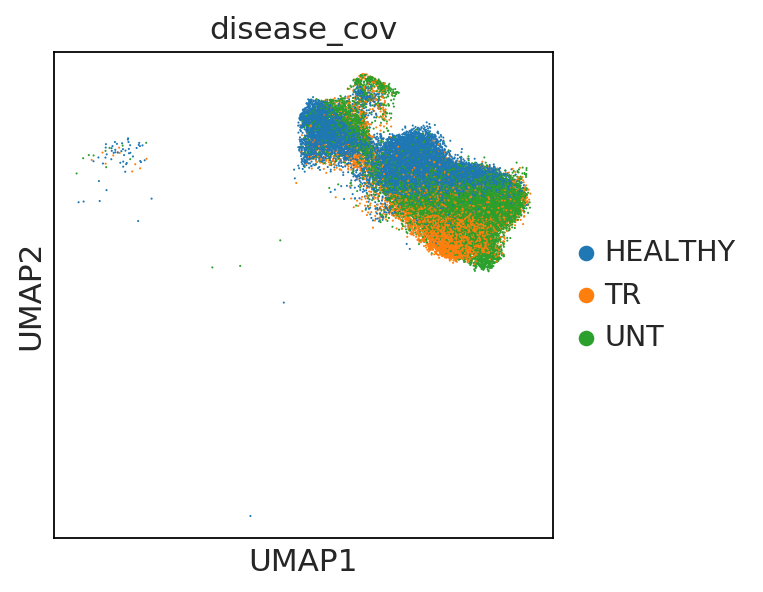

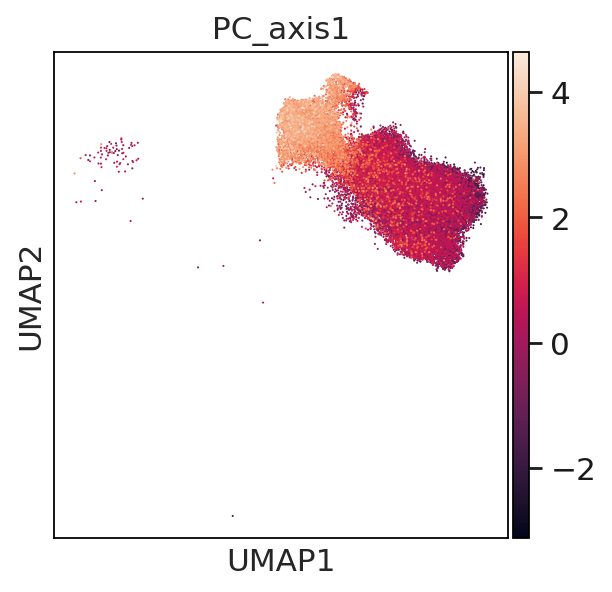

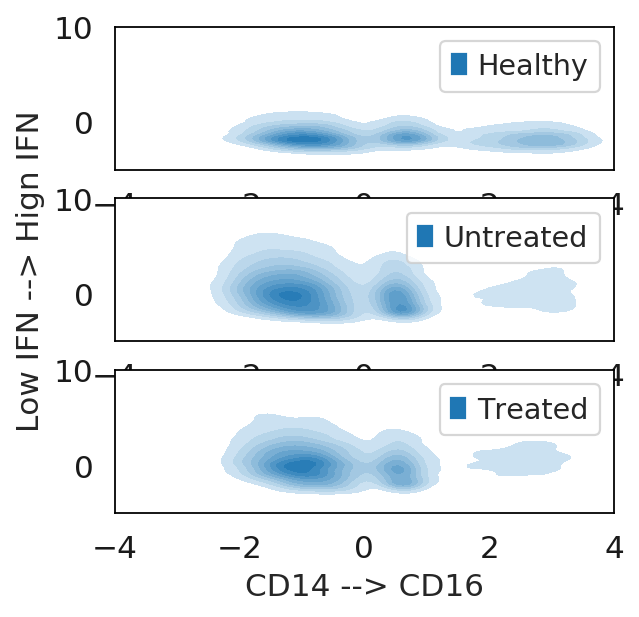

In [66]:
sns.set(font_scale=1.25)
sc.settings.set_figure_params(dpi_save=250, format='png', transparent=True)
color_map = [
    '#1f77b4', '#ff7f0e', '#2ca02c', '#d62728',
    '#9467bd', '#8c564b', '#e377c2',
    '#bcbd22', '#17becf',
    '#aec7e8', '#ffbb78', '#98df8a', '#ff9896',
    '#c5b0d5', '#c49c94', '#f7b6d2',
    '#dbdb8d', '#9edae5',
    '#ad494a', '#8c6d31']
n_bins = 20
print(adata)
# Keep only memoryand naive CD4s
bdata = adata[adata.obs['ct_cov'].isin(['Macro', 'cM', 'ncM'])]
# Must have two genes per axis.
axis1 = bdata.var_names[bdata.var_names.isin(['CD14', 'FCGR3A'])].tolist()
# Genes to order cells by
ifn_genes = pd.read_csv('/ye/yelabstore/10x.lupus/batch4.analysis/ifn.lupus.crow.etal.txt', header=None)
axis2 = bdata.var_names[bdata.var_names.isin(ifn_genes[0])].tolist()
# Order cells
PC = np.asarray(sc.pp.pca(bdata[:, axis1].X, n_comps=1, copy=True)).reshape(-1,)
bdata.obs['PC_axis1'] = list(PC)
# Order cells
PC = np.asarray(sc.pp.pca(bdata[:, axis2].X, n_comps=1, copy=True)).reshape(-1,)
bdata.obs['PC_axis2'] = list(PC)
sc.pl.umap(bdata, color='disease_cov', palette=color_map, show=True)
sc.pl.umap(bdata, color='PC_axis1', palette=color_map, show=True)
sc.pl.umap(bdata, color='PC_axis2', palette=color_map, show=True)
ax.axis([-2,4,-1,0])


# For Healthy
ind_healthy = bdata.obs['ind_cov'][bdata.obs['disease_cov']=='HEALTHY'].tolist()
healthyall_axis1 = np.asarray(bdata.obs['PC_axis1'][bdata.obs['ind_cov'].isin(ind_healthy)].values.tolist())
healthyall_axis2 = np.asarray(bdata.obs['PC_axis2'][bdata.obs['ind_cov'].isin(ind_healthy)].values.tolist())

# For UNTREATED
ind_FLARE = bdata.obs['ind_cov'][bdata.obs['disease_cov'].isin(['UNT'])].tolist()
FLAREall_axis1 = np.asarray(bdata.obs['PC_axis1'][bdata.obs['ind_cov'].isin(ind_FLARE)].values.tolist())
FLAREall_axis2 = np.asarray(bdata.obs['PC_axis2'][bdata.obs['ind_cov'].isin(ind_FLARE)].values.tolist())
    
# For TREATED
ind_TREATED = bdata.obs['ind_cov'][bdata.obs['disease_cov'].isin(['TR'])].tolist()
TREATEDall_axis1 = np.asarray(bdata.obs['PC_axis1'][bdata.obs['ind_cov'].isin(ind_TREATED)].values.tolist())
TREATEDall_axis2 = np.asarray(bdata.obs['PC_axis2'][bdata.obs['ind_cov'].isin(ind_TREATED)].values.tolist())

plt.subplot(3,1,1)
ax = sns.kdeplot(healthyall_axis1, healthyall_axis2, shade=True, shade_lowest=False, label='Healthy')
ax.legend()
ax.grid(False)
ax.axis([-4,4,-5,10])

plt.subplot(3,1,2)
ax = sns.kdeplot(FLAREall_axis1, FLAREall_axis2, shade=True, shade_lowest=False, label='Untreated')
ax.legend()
ax.set_ylabel('Low IFN --> Hign IFN')
ax.axis([-4,4,-5,10])
ax.grid(False)

plt.subplot(3,1,3)
ax = sns.kdeplot(TREATEDall_axis1, TREATEDall_axis2, shade=True, shade_lowest=False, label='Treated')
ax.axis([-4,4,-5,10])
ax.legend()
ax.set_xlabel('CD14 --> CD16')
ax.grid(False)

# 2D trajectory for cross-sectional dataset

In [47]:
filepath = '/ye/yelabstore3/Richard/PlottingScripts/ez_scanpy/V6/CLUESImmVar_processed.V6.h5ad'
bdata = sc.read(filepath)

AnnData object with n_obs × n_vars = 775678 × 1444 
    obs: 'disease_cov', 'ct_cov', 'pop_cov', 'ind_cov', 'well', 'batch_cov', 'batch', 'percent_mito', 'n_counts', 'SLEDAI', 'Broad', 'Female', 'n_genes', 'PF4', 'SDPR', 'GNG11', 'PPBP', 'PC2', 'PC3', 'PC10', 'PC12', 'PC14', 'PC27', 'PC28', 'louvain', 'leiden'
    uns: 'barcodes', 'diffmap_evals', 'genes', 'leiden', 'louvain', 'neighbors', 'pca', 'raw_counts', 'total_pbmcs'
    obsm: 'X_pca', 'X_diffmap', 'X_umap'
    varm: 'PCs'


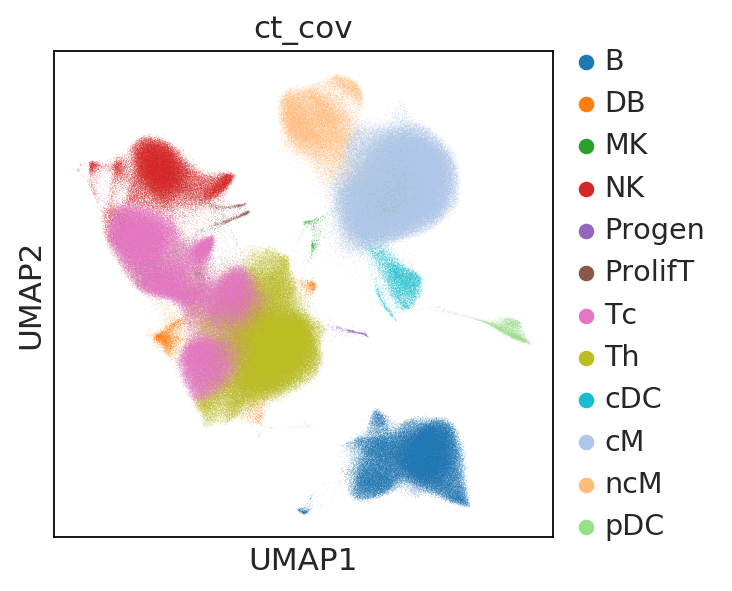

Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.


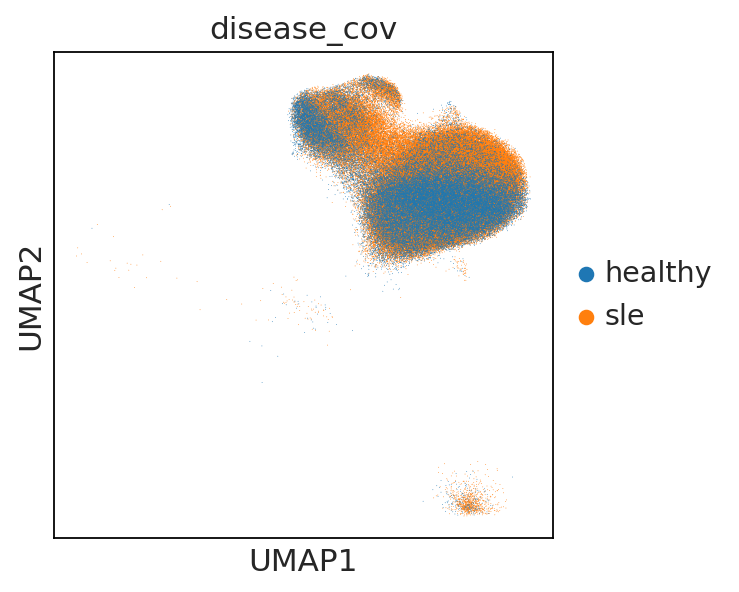

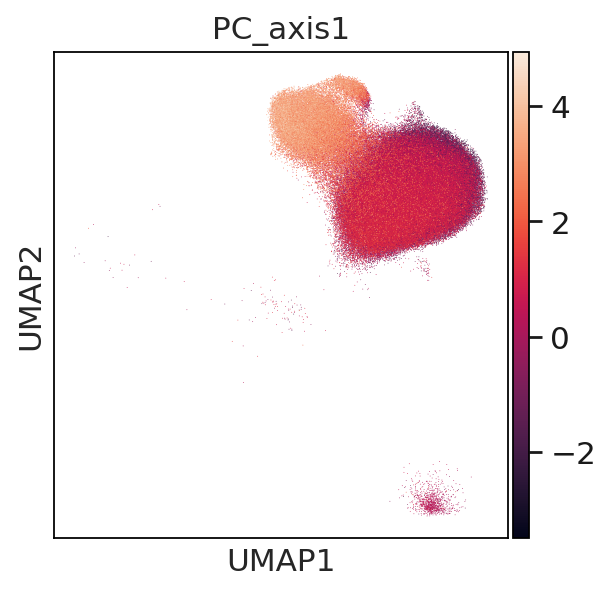

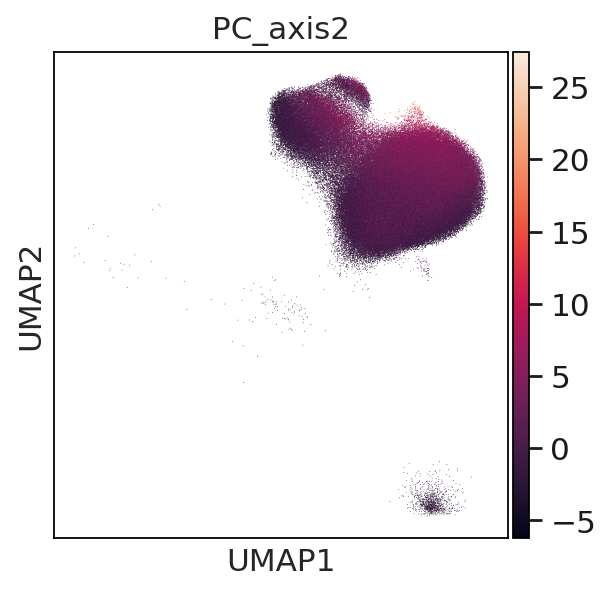

[-4, 4, -5, 10]

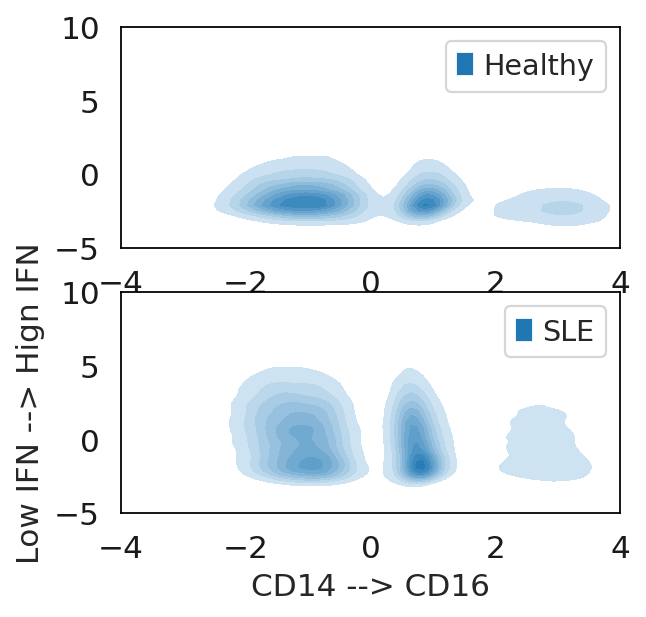

In [48]:
sns.set(font_scale=1.25)
sc.settings.set_figure_params(dpi_save=250, format='png', transparent=True)
color_map = [
    '#1f77b4', '#ff7f0e', '#2ca02c', '#d62728',
    '#9467bd', '#8c564b', '#e377c2',
    '#bcbd22', '#17becf',
    '#aec7e8', '#ffbb78', '#98df8a', '#ff9896',
    '#c5b0d5', '#c49c94', '#f7b6d2',
    '#dbdb8d', '#9edae5',
    '#ad494a', '#8c6d31']
n_bins = 20
print(bdata)
sc.pl.umap(bdata, color='ct_cov', palette=color_map, show=True)
# Keep only memory and naive CD4s
bdata = bdata[bdata.obs['ct_cov'].isin(['cM', 'ncM'])]
# Must have two genes per axis.
axis1 = bdata.var_names[bdata.var_names.isin(['CD14', 'FCGR3A'])].tolist()
# Genes to order cells by
ifn_genes = pd.read_csv('/ye/yelabstore/10x.lupus/batch4.analysis/ifn.lupus.crow.etal.txt', header=None)
axis2 = bdata.var_names[bdata.var_names.isin(ifn_genes[0])].tolist()
# Order cells
PC = np.asarray(sc.pp.pca(bdata[:, axis1].X, n_comps=1, copy=True)).reshape(-1,)
bdata.obs['PC_axis1'] = list(PC)
# Order cells
PC = np.asarray(sc.pp.pca(bdata[:, axis2].X, n_comps=1, copy=True)).reshape(-1,)
bdata.obs['PC_axis2'] = list(PC)
sc.pl.umap(bdata, color='disease_cov', palette=color_map, show=True)
sc.pl.umap(bdata, color='PC_axis1', palette=color_map, show=True)
sc.pl.umap(bdata, color='PC_axis2', palette=color_map, show=True)


# For Healthy
ind_healthy = bdata.obs['ind_cov'][bdata.obs['disease_cov']=='healthy'].tolist()
healthyall_axis1 = np.asarray(bdata.obs['PC_axis1'][bdata.obs['ind_cov'].isin(ind_healthy)].values.tolist())
healthyall_axis2 = np.asarray(bdata.obs['PC_axis2'][bdata.obs['ind_cov'].isin(ind_healthy)].values.tolist())

# For TREATED
ind_TREATED = bdata.obs['ind_cov'][bdata.obs['disease_cov'].isin(['sle'])].tolist()
TREATEDall_axis1 = np.asarray(bdata.obs['PC_axis1'][bdata.obs['ind_cov'].isin(ind_TREATED)].values.tolist())
TREATEDall_axis2 = np.asarray(bdata.obs['PC_axis2'][bdata.obs['ind_cov'].isin(ind_TREATED)].values.tolist())

plt.subplot(2,1,1)
ax = sns.kdeplot(healthyall_axis1, healthyall_axis2, shade=True, shade_lowest=False, label='Healthy')
ax.legend()
ax.grid(False)
ax.axis([-4,4,-5,10])

plt.subplot(2,1,2)
ax = sns.kdeplot(TREATEDall_axis1, TREATEDall_axis2, shade=True, shade_lowest=False, label='SLE')
ax.legend()
ax.grid(False)
ax.set_xlabel('CD14 --> CD16')
ax.set_ylabel('Low IFN --> Hign IFN')
ax.axis([-4,4,-5,10])

# Palantir Monocytes

In [49]:
import scanpy.external as sce
import palantir
sns.set(font_scale=1.25)
sc.settings.set_figure_params(dpi_save=250, format='png', transparent=True)
color_map = [
    '#1f77b4', '#ff7f0e', '#2ca02c', '#d62728',
    '#9467bd', '#8c564b', '#e377c2',
    '#bcbd22', '#17becf',
    '#aec7e8', '#ffbb78', '#98df8a', '#ff9896',
    '#c5b0d5', '#c49c94', '#f7b6d2',
    '#dbdb8d', '#9edae5',
    '#ad494a', '#8c6d31']
n_bins = 20
print(adata)
# Keep only memory and naive CD4s
bdata = adata[adata.obs['ct_cov'].isin(['Macro', 'cM', 'ncM', 'cDC', 'pDC'])]
print(bdata)
d = sce.tl.palantir(bdata)
d.filter_low = False
d.normalize = False
d.log_transform = False
d.process()

AnnData object with n_obs × n_vars = 137936 × 1174 
    obs: 'SOURCE', 'TR_UNT', 'batch_cov', 'ind_cov', 'well', 'Female', 'Broad', 'CD38|CD38|j95-01|pAbO', 'CD95|FAS|j95-02|pAbO', 'CD28|CD28|j95-07|pAbO', 'CD27|CD27|j95-08|pAbO', 'CD197|CCR7|j95-09|pAbO', 'CD19|CD19|j95-10|pAbO', 'CD161|KLRB1|j95-11|pAbO', 'CD183|CXCR3|j95-12|pAbO', 'CD4|CD4|j95-14|pAbO', 'CD3|CD3E|j95-16|pAbO', 'CD196|CCR6|j95-17|pAbO', 'HLA-DR|CD74|j95-18|pAbO', 'CD45RO|PTPRC|j95-19|pAbO', 'CD14|CD14|j95-20|pAbO', 'CD194|CCR4|j95-21|pAbO', 'CD185|CXCR5|j95-22|pAbO', 'CD25|IL2RA|j95-24|pAbO', 'CD8|CD8A|j95-25|pAbO', 'CD127|IL7R|j95-27|pAbO', 'CD45RA|PTPRC|j95-28|pAbO', 'disease_cov', 'percent_mito', 'n_counts', 'n_genes', 'PF4', 'SDPR', 'GNG11', 'PPBP', 'PC3', 'PC16', 'louvain', 'leiden', 'ct_cov', 'cell_type'
    uns: 'barcodes', 'diffmap_evals', 'genes', 'leiden', 'louvain', 'neighbors', 'pca', 'raw_counts', 'total_pbmcs', 'batch_cov_colors', 'disease_cov_colors', 'rank_genes_groups', 'louvain_colors', 'leiden_colo

KeyboardInterrupt: 

In [ ]:
start_cell = np.argmax(d.data_df['CD14'])
pr_res = palantir.core.run_palantir(d.ms_data, start_cell, num_waypoints=500)

In [ ]:
fig, ax = d.palantir.plot.plot_tsne(d.tsne)
fig, ax = d.palantir.plot.plot_tsne_by_cell_sizes(d.data_df, d.tsne)
d.palantir.plot.plot_gene_expression(d.imp_df, d.tsne, ['CD14', 'FCGR3A', 'CD163', 'IGJ', 'CD1C','IFI6'])
d.palantir.plot.plot_diffusion_components(d.tsne, d.dm_res)
d.palantir.plot.plot_palantir_results(d.pr_res, d.tsne)


# Antibody expression per disease group for all PBMCs

In [ ]:
'''
adata_obs_small = adata.obs;
keys = adata_obs_small.keys().tolist()
antibodykeys = [key for key in keys if 'pAbO' in key]
for key in antibodykeys:
    ind_mean = adata_obs_small.groupby(['disease_cov', 'ind_cov'])[key].mean()
    ind_mean = ind_mean.reset_index(name=key)
    ind_mean['disease_source_cov'] = pd.Categorical(ind_mean.apply(lambda row: row['disease_cov'], axis=1))
    perc_plot = sns.catplot(x='disease_source_cov', y=key, data=ind_mean, kind='violin', size=4, dodge=False, aspect=1, sharex=False, sharey=False)
    perc_plot.set_xticklabels(rotation=90)
    perc_plot.fig.subplots_adjust(wspace=0.4)
    sns.swarmplot(x="disease_source_cov", y=key, data=ind_mean, color="0", size=6)
    print('--------------------------' + key + '--------------------------')
    plt.show()
'''

# Average Protein Abundance per cell type and disease state

In [ ]:
'''
adata_obs_small = adata.obs;
keys = adata_obs_small.keys().tolist()
antibodykeys = [key for key in keys if 'pAbO' in key]
for key in antibodykeys:
    ind_mean = adata_obs_small.groupby(['ct_cov', 'disease_cov', 'ind_cov'])[key].mean()
    ind_mean = ind_mean.reset_index(name=key)
    ind_mean['disease_source_cov'] = pd.Categorical(ind_mean.apply(lambda row: row['disease_cov'], axis=1))
    perc_plot = sns.catplot(x='disease_source_cov', y=key, hue='ct_cov', data=ind_mean, kind='violin', col='ct_cov', size=4, dodge=False, aspect=0.5, sharex=False, sharey=False)
    perc_plot.set_xticklabels(rotation=90)
    perc_plot.fig.subplots_adjust(wspace=0.4)
    for ct_i in list(range(len(ind_mean.ct_cov.cat.categories))) :
        ct = ind_mean.ct_cov.cat.categories[ct_i]
        sns.swarmplot(x="disease_source_cov", y=key, data=ind_mean[ind_mean.ct_cov == ct], color="0", size=3, ax=perc_plot.axes[0,ct_i])
        perc_plot.axes[0,ct_i].get_yaxis().label.set_visible(False)
    print('--------------------------' + key + '--------------------------')
    plt.show()
'''

# Average mRNA Abundance per cell type and disease state

In [ ]:
'''
keys = adata.obs.keys().tolist()
antibodykeys = [key for key in keys if 'pAbO' in key]
Abgenes0 = [key.split('|')[1] for key in antibodykeys]
print(Abgenes0)
Abgenes = []
for Ab in Abgenes0:
    try:
        adata.obs[Ab] = adata[:, Ab].X
        Abgenes.append(Ab)
    except:
        continue
print(Abgenes)
adata_obs_small = adata.obs;

for ii in range(len(Abgenes)):
    ind_mean = adata_obs_small.groupby(['ct_cov', 'disease_cov', 'ind_cov'])[Abgenes[ii]].mean()
    ind_mean = ind_mean.reset_index(name=Abgenes[ii])
    ind_mean['disease_source_cov'] = pd.Categorical(ind_mean.apply(lambda row: row['disease_cov'], axis=1))
    perc_plot = sns.catplot(x='disease_source_cov', y=Abgenes[ii], hue='ct_cov', data=ind_mean, kind='violin', col='ct_cov', size=4, dodge=False, aspect=0.5, sharex=False, sharey=False)
    perc_plot.set_xticklabels(rotation=90)
    perc_plot.fig.subplots_adjust(wspace=0.4)
    for ct_i in list(range(len(ind_mean.ct_cov.cat.categories))) :
        ct = ind_mean.ct_cov.cat.categories[ct_i]
        sns.swarmplot(x="disease_source_cov", y=Abgenes[ii], data=ind_mean[ind_mean.ct_cov == ct], color="0", size=3, ax=perc_plot.axes[0,ct_i])
        perc_plot.axes[0,ct_i].get_yaxis().label.set_visible(False)
    print('--------------------------' + Abgenes[ii] + '--------------------------')
    plt.show()
'''